# **Final Project - Explainer Notebook**

This notebook was created for the final project of the course _02806 Social Data Analysis and Visualization_ at _Technical University of Denmark_.

By Group 66:

-   Aleksandar Lukic - s194066
-   Paula Barho - s242926
-   Victor Gustav Harbo Rasmussen - s204475

<span style="color:DodgerBlue">
Throughout the Notebook, we will be using a blue style to easily disthinguish between code output and our written explanations. 
</span>
<br> <br>
The written answers to the section questions of the assignment are left in white.

# **1. Motivation**

- **What are the datasets**  
We are using the following datasets:
  - CPH Districts (`bydel.geojson` [Open Data DK - Bydele](https://www.opendata.dk/city-of-copenhagen/bydele))

  - Car Ownership (`KKBIL1: Privatbiler efter distrikt og drivmiddel` [Københavns Kommunes Statistikbank](https://kk.statistikbank.dk))

  - Parking Spaces (`Parkeringspladser` [Open Data DK - Parkeringspladser](https://www.opendata.dk/city-of-copenhagen/parkeringspladser))

  - Parking Counts (`Parkeringstællinger` [Open Data DK - Parkeringstællinger](https://www.opendata.dk/city-of-copenhagen/parkeringstaellinger))

- **Why did you choose this/these particular dataset(s)?**  
Parking is a big stress point for a lot of motorists, especially in larger cities. This have been and should be a concern for legislators and city planners and we wanted to see if there has been positive or negative changes over the years. The world is changing and so are the cities. Perhaps parking opportunities are shrinking to try and motivate people to use greener transportation, or there is more parking, but it has been obfuscated leaving car owners frustrated. To figure out how parking has changed and if there are really fewer parking opportunities in Copenhagen, we will look at a broad view of the city and explore if and why parking has changed over the last decades.  

- **What was your goal for the end user's experience?**  
We want any site visitor to easily get a sense of the overall goal of the website upon immediately entering the site. It should be clear that the project is exploring parking in Copenhagen and how it has evolved. The website is not a place to *find* an actual parking spot, but it should enlighten people as to *why* they cannot find parking in the city. The tabs should allow for quick access to specific topics and allows the user to quickly find their specific interest on the topic. 

---

# **2. Basic Stats – Understanding the Dataset**

**Data Cleaning and Preprocessing**

We did individual preprocessing and data cleaning for both datasets. These can be seen in the Data_overview notebook.
In brief, we:
- Removed NaN rows
- Renamed column headers to English terms (e.g. "vejkode" -> "street_code")
- Aligned row string values that were typos or concerning the same thing despite varying names (e.g. "Kgs. Enghave" -> "Vesterbro-Kongens Enghave")
- Removed columns we did not use for our calculations

For the Car Ownership data, we also include the start year and end year specifically since it is not included in the data by default. 

## **Overview of datasets**

<span style="color:DodgerBlue">

The notebook goes through all data used for the project. While much code and many exploratory visualisations have been omitted for the sake of brevity, the included ones provide the needed information to understand the problem of parking in Copenhagen and include every visualisation also used on the webpage.

</span>

### **Preamble**

<span style="color:DodgerBlue">

This section contains the python imports, Pandas settings and OS paths used in this project

</span>


In [206]:
# Used for interactive plots
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource, Select, HoverTool, CustomJS, NumeralTickFormatter, MultiSelect
from bokeh.layouts import column
from bokeh.io import output_notebook, show, output_file, save
from bokeh.palettes import viridis
from bokeh.embed import file_html
from bokeh.resources import CDN

# Used for creating maps using GeoJSON data
import folium
from folium.plugins import HeatMap, HeatMapWithTime

# Used for data manipulation and analysis
import json
import math
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import plotly.express as px
import re

# Used for geospatial data manipulation
from shapely import wkt
from shapely.geometry import shape, LineString, MultiLineString

In [207]:
# Set pandas display options to show all columns for .head command
pd.set_option("display.max_columns", None)  
pd.set_option("display.width", None)   
pd.set_option("future.no_silent_downcasting", True)

In [208]:
# Path used for loading and saving data files
data_path = os.path.abspath(os.path.join(os.pardir, "projectData"))

# Path used for loading and saving the plots
plots_path = os.path.abspath(os.path.join(os.pardir, os.path.join("plots", "Project")))

In [209]:
# Console output settings
MAX_ENTRIES = 15
NO_OF_UNDERSCORES = 40

# Plot settings
FONT_FAMILY_DEFAULT = "monospace"

FONT_FAMILY_LABEL = FONT_FAMILY_DEFAULT
FONT_COLOR_LABEL = "black"
FONT_SIZE_LABEL = 14

FONT_DICT_LABEL = {
    "family": FONT_FAMILY_LABEL,
    "color": FONT_COLOR_LABEL,
    "size": FONT_SIZE_LABEL
}

def print_df_overview(df):
    print("Column and row content overview:")
    for col in df.columns:
        unique_vals = df[col].unique()
        print(f"{col} - has {len(unique_vals)} unique entries:")
        
        # Limit output to max no. of entries
        unique_vals = unique_vals if len(unique_vals) < MAX_ENTRIES else unique_vals[:MAX_ENTRIES]
        print(unique_vals)
        print("-" * NO_OF_UNDERSCORES)

### **Dataset 1: GeoJSON CPH Districts**

<span style="color:DodgerBlue">

This section covers geographical data used to map city districts in Copenhagen.

The GeoJSON file, _**bydele.geojson**_, containing the polygon features used for mapping the city districts can be downloaded from [Open Data DK - Bydele](https://www.opendata.dk/city-of-copenhagen/bydele).

Loading geojson into python as json response:

</span>

In [210]:
# Read shapefile from the provided geojson file
geojson_name = "bydel.geojson"
geojson_path = os.path.join(data_path, geojson_name)

# Open geojson data to load shape of police districts
with open(geojson_path) as response:
    geojson_districts = json.load(response)

<span style="color:DodgerBlue">

Below is a quick overview showing some quantative metrics on the GeoJSON data.

Additionally, the content of the feature properties are compiled into a pandas dataframe for easy overview.

</span>

In [211]:
print("Dataset: GeoJSON of CPH")
file_size = os.path.getsize(geojson_path)/1024
print(f"- File Size: {file_size:.2f} KB")

print("\nGeoJSON feature properties:")
for p in geojson_districts["features"][0]["properties"]:
    print(f"- {p}")

Dataset: GeoJSON of CPH
- File Size: 244.71 KB

GeoJSON feature properties:
- id
- bydel_nr
- navn
- areal_m2
- ogc_fid


<span style="color:DodgerBlue">
The GeoJSON dataset contains the gemometric polygons, mapped using longitude/latitude coordinates. In this project, the data used to describe the areas covered by these polygons will be mapped using the district names. The name will thus work as the identifier property throughout this notebook as this is the only key in common with the other datasets in this notebook. The _areal_m2_ property will also remain to give the reader a sense of the spacial scale for each district.
</span>

In [212]:
# Create Pandas Dataframe to store the geojson properties
df_geojson = pd.DataFrame(columns=["Id", "District_No", "Name", "Area"])
df_geojson = df_geojson.astype({"Id": "uint8", "District_No": "uint8", "Name": str, "Area": float})

# Traverse each features in the GeoJSON data and extract the properties values.
# Then, create row from values and append(concat) to dataframe. 
for f in geojson_districts["features"]:
    new_row = pd.DataFrame(data=[[
        f["properties"]["id"],
        f["properties"]["bydel_nr"], 
        f["properties"]["navn"], 
        f["properties"]["areal_m2"]
    ]], columns=[
        "Id", 
        "District_No", 
        "Name", 
        "Area"
    ])
    df_geojson = pd.concat([df_geojson, new_row], axis=0, ignore_index=True)

# Sort values of dataframe by City district name
df_geojson = df_geojson.sort_values(
    by=["Name"], 
    axis=0,
    ascending=True)

display(df_geojson)

,Id,District_No,Name,Area
0,33,10,Amager Vest,19364649.0
9,9,9,Amager Øst,9345320.0
8,8,8,Bispebjerg,6829937.0
4,7,7,Brønshøj-Husum,8740777.0
6,1,1,Indre By,10471832.0
7,3,3,Nørrebro,4107777.0
3,35,5,Valby,9235113.0
5,6,6,Vanløse,6699013.0
1,34,4,Vesterbro-Kongens Enghave,8262147.0
2,36,2,Østerbro,9772935.0


*Table 1: Overview over the GeoJSON dataframe.*

<span style="color:DodgerBlue">
The GeoJSON format doesn't support an easy overview option for of the polygons, thus the above table is made to show all the polygon properties for each district. The property names have been translated to English for easier readability. The _Id_ and _District_No_ properties will not be used in the analysis as they are not aligned with the other datasets.
</span>

### **Dataset 2: Car Ownership**

<span style="color:DodgerBlue">

This section covers the freely accessible dataset with registered vehicle ownership in Copenhagen between 2006 and 2024.

The private ownership of cars in Copenhagen has been counted since 2006. The dataset can be found at [Købanhavns Kommunes Statistikbank](https://kk.statistikbank.dk) under the _Privatbiler_ tab. There are multiple options for which data to extract, based on fuel type, district, family structure, vehicle type etc.. 

For this project, the dataset collected can be found folliwng these steps: 

1. Go to the website and follow these tabs:
- `Privatbiler` 
    - `Personbiler` 
        - `KKBIL1: Privatbiler efter distrikt og drivmiddel`

2. Select all rows in each dropdown, except the "_København i alt_" under _DISTRIKT_ and "_Drivmiddel i alt_" under _DRIVMIDDEL_. 
3. Click "_VIS TABEL_". 
4. Make sure to toggle off "_Inkl. koder i sep. kolonner_" and "_Inkl. fodnoter mv._".
5. Select "_Semikolonsepareret (*.csv)_" in the dropdown "_Åbn / gem som..._".
6. Rename the .csv to "KKBIL.csv"

</span>

Disclaimer:

<span style="color:DodgerBlue">

The dataset is being activily maintained, so values may vary over time.

The cleaned data produced from this notebook has excluded NaN rows from the original dataset.

This means, that years with NaN values, are not present in the cleaned dataset, e.g. 

    INVALID: "Diesel", "Amager Vest", "Amager Vest", "Ørestad Syd", 2006, NaN

    VALID: "Diesel", "Amager Vest", "Amager Vest", "Ørestad Syd", 2009, 0

</span>

<span style="color:DodgerBlue">

The downloaded dataset now needs to be loaded into Python using Pandas. This dataset will then be used to produce a cleaned dataset, which will be used in this project.

</span>

In [213]:
# Load csv data into pandas dataframe
cars_registered_name = "KKBIL.csv"
cars_registered_path = os.path.join(data_path, cars_registered_name)
df_owner = pd.read_csv(cars_registered_path, encoding="ISO-8859-1")

# RAW downloaded data
display(df_owner.head())

,Benzin,Bydel - Indre By,8675,9015,9016,8831,8758,8572,8489,8429,8549,8671,8921,9003,8991,9122,9276,9593,9250,8810,8493
0,Benzin,Bydel - Østerbro,12302,12666,12870,12782,12592,12354,12184,12022,12162,12337,12631,12901,13238,13344,13530,14098,14048,13470,12842
1,Benzin,Bydel - Nørrebro,8930,9197,9276,8869,8616,8382,8166,8061,8244,8589,8783,9112,9558,9677,9825,10488,10614,10157,9720
2,Benzin,Bydel - Vesterbro/Kongens Enghave,6634,7248,7499,7733,7753,7846,7636,7600,7868,8105,8381,8767,9200,9606,9949,10616,10987,10611,10045
3,Benzin,Bydel - Valby,8867,9094,9166,9114,9121,9102,9002,9020,9228,9472,9643,9888,10234,10541,10810,11477,11510,11237,10821
4,Benzin,Bydel - Vanløse,8146,8289,8262,8097,8033,8006,7945,7937,7952,8110,8296,8313,8451,8548,8625,8817,8843,8500,8291


*Table 2: Head of the dataframe from the car ownership dataset.*

Restructure and clean the dataset:

<span style="color:DodgerBlue">

This section covers how we cleaned and transformed the data to provide a better analysis and documentation of our findings.

Due to the format of the downloaded dataset, the years are not indicated in the columns of the dataframe. 

Thus, this is handled manually through melting, transposing and cleaning the dataset.

</span>


In [214]:
# Manually assign the start and end year of the dataset, depending on time fetched from website
YEAR_START = 2006
YEAR_END = 2024

# Create new columns to store the fuel types, city districts and each year since the dataset was created
new_cols = ["FuelType", "CityDistrict", *list(range(YEAR_START, YEAR_END+1, 1))]

# Transpose the table, so that the current header becomes first column.
# Then transpose again and assign the new custom header.
df_ncols = (df_owner.T.reset_index().T.reset_index(drop=True).set_axis(new_cols, axis=1))

# Melt the number of registered vehicles and years with the remaining columns,
# making new columns to store the years and no of vehicles owned. 
df_melted = df_ncols.melt(
    id_vars=[
        "FuelType", 
        "CityDistrict"
    ], 
    var_name="Year", 
    value_name="NoOfVehicles"
)

# Enforce/convert the datatypes for each column
df_melted["FuelType"] = df_melted["FuelType"].astype(str)
df_melted["CityDistrict"] = df_melted["CityDistrict"].astype(str)
df_melted["Year"] = df_melted["Year"].astype("uint16")

# Convert no of vehicles to int, first making non-numeric values NaN, then remove all NaN-values.
df_melted["NoOfVehicles"] = pd.to_numeric(df_melted["NoOfVehicles"], errors="coerce")
df_melted = df_melted.dropna(subset=["NoOfVehicles"])
df_melted["NoOfVehicles"] = df_melted["NoOfVehicles"].astype(int)

# Sort the dataframe alphabetically and chronologically
df_melted = df_melted.sort_values(
    by=[
        "FuelType",
        "CityDistrict",
        "Year",
    ], 
    axis=0,
    ascending=True)

Remove out-of-scope rows and melt districts:

<span style="color:DodgerBlue">

A few of the datapoints in the downloaded data do not contain either the district or a valid fuel type.

Thus, these rows are removed. 

Additionally, rows containing "Bydel" and "Lokaludvalg" are extracted from the main dataframe and stored separately.

</span>

In [215]:
# Remove noninformative rows for "other" and "non-desclosed" fuel types
df_melted = df_melted[df_melted["FuelType"]!="Øvrige og uoplyst"]

# Remove districts outside of CPH
df_melted = df_melted[~df_melted["CityDistrict"].str.contains("Uden for inddeling", case=False, na=False)]

# Extract rows containing "Bydel" and "Lokaludvalg" from main dataframe
df_bydel = df_melted[df_melted["CityDistrict"].str.contains("Bydel", case=False, na=False)]
df_lokaludvalg = df_melted[df_melted["CityDistrict"].str.contains("Lokaludvalg", case=False, na=False)]

# Remove rows containing "Bydel" and "Lokaludvalg" from main dataframe
df_melted = df_melted[~df_melted["CityDistrict"].str.contains("Bydel|Lokaludvalg", case=False, na=False)]

Extract City district, Local district and Neighbourhood from the CityDistrict column:

<span style="color:DodgerBlue">

In this dataset, the "district" contain both the City district, Local district and Neighbourhood.

To allign the dataset better with the GeoJSON data, the types of districts are separated into each their own column. 

Additionally, each unique value of City district, Local district and Neighbourhood, are displayed in the console as lists.

</span>

In [216]:
# Create copy of dataframe and add a new column for "Lokaludvalg"
df_clean = df_melted.copy()
df_clean.insert(1, "Lokaludvalg", "X")

# Extract list with all unique local disctrict names
lokaludvalg_unique = df_lokaludvalg["CityDistrict"].unique().tolist()
lokaludvalg_list = []
for item in lokaludvalg_unique:
    lokaludvalg_list.append(item.replace("Lokaludvalg - ", ""))

# Print unique values in local district list
print("Lokaludvalg unique values:")
for item in lokaludvalg_list:
    print("-", item)

# Fill the values in the local district column based on mask made of the district is present in the CityDistrict column.
for district in lokaludvalg_list:
    mask = df_clean["CityDistrict"].str.contains(district, na=False)
    df_clean.loc[mask, "Lokaludvalg"] = district
    df_clean.loc[mask, "CityDistrict"] = df_clean.loc[mask, "CityDistrict"].str.replace(district, "", n=1).str.replace("-", "", n=1).str.strip()

Lokaludvalg unique values:
- Amager Vest
- Amager Øst
- Bispebjerg
- Brønshøj-Husum
- Christianshavn
- Indre By
- Kgs. Enghave
- Nørrebro
- Valby
- Vanløse
- Vesterbro
- Østerbro


<span style="color:DodgerBlue">
This list show all the Lokaludvalg, "Local councils" in English, which in Copenhagen may represent certain supdivisions of city districts. Due to the GeoJSON dataset being centered on the city districts, these rows related to Lokaludvalg has to be handled and mapped to their respective districts. 
</span>

In [217]:
# Add a new column for "Bydel"
df_clean.insert(1, "Bydel", "X")
df_clean["Bydel"] = df_clean["Lokaludvalg"]

# Extract list with all unique city disctrict names
bydel_unique = df_bydel["CityDistrict"].unique().tolist()
bydel_list = []
for r in bydel_unique:
    bydel_list.append(r.replace("Bydel - ", "").replace("/", "-"))

# Print unique values in local district list
print("Bydel unique values:")
for item in bydel_list:
    print("-", item)

Bydel unique values:
- Amager Vest
- Amager Øst
- Bispebjerg
- Brønshøj-Husum
- Indre By
- Nørrebro
- Valby
- Vanløse
- Vesterbro-Kongens Enghave
- Østerbro


<span style="color:DodgerBlue">
This list shows the Bydel, "City district" in English, which are the geographical sections of the city of Copenhagen, used for city planing and communial planing. These districts align with the GeoJSON districts, thus the Lokaludvalg will be mapped to these districts.
</span>

In [218]:
# Examine differences between local district and city district values using set-opperations
s_lokal = set(lokaludvalg_list)
s_bydel = set(bydel_list)
print(f"Uniquely in Lokaludvalg:")
for item in list(s_lokal.difference(s_bydel)):
    print("-", item)

print("")

print(f"Uniquely in Bydel:")
for item in list(s_bydel.difference(s_lokal)):
    print("-", item)

Uniquely in Lokaludvalg:
- Vesterbro
- Kgs. Enghave
- Christianshavn

Uniquely in Bydel:
- Vesterbro-Kongens Enghave


<span style="color:DodgerBlue">
By comparing the the lists for Lokaludvalg and Bydel, we can see that in most cases the values are identical, meaning that the can be mapped directly, e.g. Lokaludvalg Nørrebro becomes Bydel Nørrebro in the cleaned dataset.
<br><br>
To handle the Lokaludvalg which are not identical to the Bydel, the difference in the Lokaludvalg and Bydel sets are displayed above.
</span>

In [219]:
# Manually convert outliers by using masks.
# These were defined by comparing the locations with official city districts
mask = df_clean["Bydel"].str.contains("Kgs. Enghave|Vesterbro", na=False)
df_clean.loc[mask, "Bydel"] = "Vesterbro-Kongens Enghave"
mask = df_clean["Bydel"].str.contains("Christianshavn", na=False)
df_clean.loc[mask, "Bydel"] = "Indre By"

# Rename columns to English terms
df_clean_renamed = df_clean.rename(columns={
    "Bydel": "CityDistrict",	
    "Lokaludvalg": "LocalDistrict",
    "CityDistrict": "Neighbourhood",
})

# Extract list with all unique city disctrict names
neighbourhood_unique = df_clean_renamed["Neighbourhood"].unique().tolist()
neighbourhood_list = []
for r in neighbourhood_unique:
    neighbourhood_list.append(r)
# Print unique values in local district list
print("Neighbourhood unique values:")
for item in neighbourhood_list:
    print("-", item)

Neighbourhood unique values:
- Amagerbro Vest
- Bryggen Syd
- Faste Batteri
- Gamle Bryggen
- Grønjordssøen (Ørestad Nord og Vejlandskvarter)
- Kolonihavekvarteret
- Sundbyvester
- Sundholmsvejs kvarteret
- Urbanplanen
- Ørestad City
- Ørestad Syd
- Amagerbro Øst
- Nordøstamager
- Sundbyøster
- Villakvartererne
- Bispebjerg
- Emdrup
- Nordvest
- Utterslev
- Ryparken-Lundehus
- Bellahøj
- Brønshøj
- Husum
- Husum Nord
- Tingbjerg
- Holmen og Refshaleøen
- Neden Vandet
- Oven Vandet
- Frederiksstaden
- Gammelholm og Nyhavn
- Metropolzonen
- Middelalderbyen
- Nansensgade-kvarteret
- Øster Farimagsgade-kvarteret
- Østerport
- Bavnehøj
- Gl. Sydhavn
- Holmene
- Blågårdskvarteret/Assistens/Rantzausgade
- Guldbergskvarteret/Panum/Ravnsborggade
- Haraldsgade-kvarteret
- Mimersgade-kvarteret/ Nørrebro St.
- Stefansgade/Nørrebroparken/Lundtoftegade
- Gl. Valby
- Syd
- Valby Sydvest
- Vigerslev
- Ålholm
- Grøndals Park Kvarter
- Jernbane Allé Kvarter
- Jyllingevej Kvarter
- Sallingvej Kvarter
- C

<span style="color:DodgerBlue">
To address the outliers in the Lokaludvalg list above, we mapped the Lokaludvalg "Kgs. Enghave" and "Vesterbro" to the Bydel "Vesterbro-Kongens Enghave", while the Lokaludvalg "Christianshavn" falls under the Bydel "Indre by".
<br><br>
Additionally, in order to map the cleaned dataset to the GeoJSON polygons, the Neighbourhoods were extracted from the Bydel and Lokaludvalg, resulting in three separate columns; "CityDistrict", "LocalDistrict"  and "Neighbourhood". 
</span>

Save and display the cleaned data into a new csv:

<span style="color:DodgerBlue">

After cleaning and preparing the dataset, it is saved as a new .csv file.

</span>

In [220]:
# Copy dataframe to be saved and sort it
df_clean_renamed = df_clean_renamed.sort_values(["FuelType", "CityDistrict", "LocalDistrict", "Neighbourhood", "Year"], ascending=True)
df_ownership = df_clean_renamed.copy()

# Store cleaned dataframe to new csv file
cleaned_name = "private_vehicle_ownership_copenhagen.csv"
cleaned_path = os.path.join(data_path, cleaned_name)
df_ownership.to_csv(cleaned_path, index=False)

display(df_ownership.head())

,FuelType,CityDistrict,LocalDistrict,Neighbourhood,Year,NoOfVehicles
80,Benzin,Amager Vest,Amager Vest,Amagerbro Vest,2006,1030
540,Benzin,Amager Vest,Amager Vest,Amagerbro Vest,2007,1055
1000,Benzin,Amager Vest,Amager Vest,Amagerbro Vest,2008,1108
1460,Benzin,Amager Vest,Amager Vest,Amagerbro Vest,2009,1071
1920,Benzin,Amager Vest,Amager Vest,Amagerbro Vest,2010,1035


*Table 3: Head of the cleaned dataframe from the car ownership dataset which will be used for the data analysis.*

<span style="color:DodgerBlue">

Below is a quick overview showing some quantative metrics on the dataset after cleaning.

</span>

In [221]:
print("Dataset: Car-ownership in CPH")

# Size of cleaned data
memory_mb = os.path.getsize(cleaned_path) / (1024) 
print(f"- Size of csv: {memory_mb:.2f} KB")

# Dimensions of table
print("- No cols:", df_ownership.shape[1])
print("- No rows:", df_ownership.shape[0])

# Column names and types
print("\nColumn names:")
max_len = len(max(df_ownership.columns, key=len))
for c in df_ownership.columns:
    print(f"- {c:{' '}{'<'}{max_len}} : {type(df_ownership[c].iloc[0])}")

Dataset: Car-ownership in CPH
- Size of csv: 261.61 KB
- No cols: 6
- No rows: 4846

Column names:
- FuelType      : <class 'str'>
- CityDistrict  : <class 'str'>
- LocalDistrict : <class 'str'>
- Neighbourhood : <class 'str'>
- Year          : <class 'numpy.uint16'>
- NoOfVehicles  : <class 'numpy.int64'>


<span style="color:DodgerBlue">
The cleaned dataset now shows the ownership of cars in Copenhagen for each year since 2006 and can be sorted based on fuel type and City district. The Local district and Neighbourhood columns are not used in this project, but remain available for any potential future analysis.
</span>

### **Dataset 3: Parking Spaces**

<span style="color:DodgerBlue">

This section covers the freely accessible dataset with registered parking spaces in Copenhagen between 2003 and 2025.

</span>

<span style="color:DodgerBlue">

The available parking spaces are activily counted in Copenhagen and the .csv dataset, titled _p\_pladser.csv_, can be downloaded from [Open Data DK - Parkeringspladser](https://www.opendata.dk/city-of-copenhagen/parkeringspladser). 

The dataset shows legal parking spaces during the day (7am-6pm) at street level (on public and private shared roads), parking spaces in publicly owned parking facilities as well as parking spaces without a parking system. 

Parking options for electric cars, shared cars, taxis and disabled drivers are noted by either parking type, restriction or both.

The dataset includes parking spaces reserved for embassies and consulates, which also fall under parking type and restriction.

</span>

Load csv data into Pandas Dataframe

<span style="color:DodgerBlue">

The downloaded dataset now needs to be loaded into Python using Pandas.

This dataset will then be used to produce a cleaned dataset, which will be used in this project.

</span>

In [222]:
# Load csv data into pandas dataframe
parking_spaces_name = "parking_spaces.csv"
parking_spaces_path = os.path.join(data_path, parking_spaces_name)
df_spaces = pd.read_csv(parking_spaces_path)

# RAW downloaded data
display(df_spaces.head())

,FID,vejkode,vejnavn,antal_pladser,restriktion,vejstatus,vejside,bydel,p_ordning,p_type,p_status,rettelsedato,oprettelsesdato,x,id,taelle_id,startdato_midlertidigt_nedlagt,slutdato_midlertidigt_nedlagt,restriktionstype,restriktionstekst,taelle_note,delebilsklub,aendring_p_ordning,uuid,ogc_fid,wkb_geometry
0,p_pladser.1,4,Abel Cathrines Gade,10.0,nej,Offentlig vej,Lige husnr.,Vesterbro-Kongens Enghave,Grøn betalingszone,Uafmærket parkering,NaN,2021-01-15T20:16:10.536,2003-05-28T00:00:00,NaN,15287,128.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f091dc0c-e4c1-49d1-8c0e-f2abe9cf3274,1,MULTILINESTRING ((12.558951218164538 55.671519...
1,p_pladser.2,4,Abel Cathrines Gade,4.0,nej,Offentlig vej,Ulige husnr.,Vesterbro-Kongens Enghave,Grøn betalingszone,Uafmærket parkering,NaN,2021-01-15T20:16:13.164,2003-05-28T00:00:00,NaN,15282,128.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,f78e2d50-6d05-4efe-82da-ac3306e91544,2,MULTILINESTRING ((12.559540823191533 55.671430...
2,p_pladser.3,4,Abel Cathrines Gade,4.0,nej,Offentlig vej,Ulige husnr.,Vesterbro-Kongens Enghave,Grøn betalingszone,Uafmærket parkering,NaN,2025-01-30T09:03:14.719,2003-05-28T00:00:00,NaN,15284,128.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6f1dcd37-a01d-4c43-af33-1ca17476e116,3,MULTILINESTRING ((12.558251725661727 55.671793...
3,p_pladser.4,4,Abel Cathrines Gade,1.0,nej,Offentlig vej,Ulige husnr.,Vesterbro-Kongens Enghave,Grøn betalingszone,Uafmærket parkering,NaN,2021-01-15T20:16:10.193,2003-05-28T00:00:00,NaN,15285,128.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9a26e4f5-758f-48ab-ad0d-e0549ecad115,4,MULTILINESTRING ((12.55787572262436 55.6718996...
4,p_pladser.5,4,Abel Cathrines Gade,2.0,nej,Offentlig vej,Ulige husnr.,Vesterbro-Kongens Enghave,Grøn betalingszone,Uafmærket parkering,oprettet,2021-01-15T20:16:17.972,2003-05-28T00:00:00,NaN,44281,128.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,aa712abe-4293-4c75-b991-af4f3f5c74c6,5,MULTILINESTRING ((12.55863434613667 55.6716855...


*Table 4: Head of the dataframe from the parking spaces dataset.*

Preview of Parking spaces dataset with column description:

<span style="color:DodgerBlue">

The original dataset from Open Data DK contains 26 columns and 28762 rows.

In the overview below, the original column name contains the columns in the downloaded csv, while the renamed column name contains the names used in the cleaned dataset.

Note, that columns indicated by NaN are not included in the cleaned dataset, as these were not deemed relevant for further processing.

</span>

| Original Column name              | Renamed Column name           | Description   |
| ------                            | ------                        | ------        |
|**FID**                            | FID                           | Identifier for Parking Space Object strictly used for this dataset|
|**vejkode**                        | street_code                   | Numeric Identifier for a given street |
|**vejnavn**                        | street_name                   | Street name|
|**antal_pladser**                  | no_of_spaces                  | Number of parking spaces registered under Parking Space Object |
|**restriktion**                    | restriction                   | Restriction boolean indicator |
|**vejstatus**                      | NaN                           | Street type, e.g. public road or private area |
|**vejside**                        | NaN                           | Side of the road, i.e. even or odd numbered house numbers |
|**bydel**                          | district                      | District, e.g. Nørrebro, Valby, etc. |
|**p_ordning**                      | parking_type                  | Parking Space Object type, e.g. Electric car parking w. charger, Handicap, Blue zone, etc. |
|**p_type**                         | NaN                           | Parking Space Object physical type, e.g. Marked parking, 45deg marked parking, |
|**p_status**                       | NaN                           | Status of whether the parking spot is "created" or "temporarily out of service" |
|**rettelsedato**                   | date_correction               | Date of correction |
|**oprettelsesdato**                | date_creation                 | Date of creation |
|**x**                              | NaN                           | Individual Text description for Parking Space Object type, e.g. license plate for private handicap parking spot |
|**id**                             | NaN                           | Unique Identifer for each Parking Space Object |
|**taelle_id**                      | NaN                           | Identifier for internal counting/tally procedures
|**startdato_midlertidigt_nedlagt** | NaN                           | Start date for registered Out of Service (only NaN in dataset) |
|**slutdato_midlertidigt_nedlagt**  | NaN                           | End date for registered Out of Service (only NaN and a single entry in dataset) |
|**restriktionstype**               | restriction_type              | Restriction type name |
|**restriktionstekst**              | restriction_text              | Restriction description, e.g. "8-18" if parking not allowed in given hours |
|**taelle_note**                    | NaN                           | Text notes for internal counting/tally procedures |
|**delebilsklub**                   | NaN                           | Car sharing company |
|**aendring_p_ordning**             | changed_to_electric_parking   | Indicator if parking space has been converted to Electric parking w.o. charger |
|**uuid**                           | NaN                           | Unique Identifer for each Parking Space Object |
|**ogc_fid**                        | NaN                           | Numeric Identifier for Parking Space Object strictly used for this dataset|
|**wkb_geometry**                   | NaN                           | Location of Parking Space Object, in the form of a MultiLineString with altitude/longitude coordinates |

*Table 5: Overview over the features/columns in the parking spaces dataset including the translated names and indications whether they were used for the data analysis.*

In [223]:
# Quick overview of some unique value examples
print_df_overview(df_spaces)

Column and row content overview:
FID - has 28762 unique entries:
['p_pladser.1' 'p_pladser.2' 'p_pladser.3' 'p_pladser.4' 'p_pladser.5'
 'p_pladser.6' 'p_pladser.7' 'p_pladser.8' 'p_pladser.9' 'p_pladser.10'
 'p_pladser.11' 'p_pladser.12' 'p_pladser.13' 'p_pladser.14'
 'p_pladser.15']
----------------------------------------
vejkode - has 2008 unique entries:
[ 4  8 72 12 16 20 24 28 32 36 40 44 48 52 54]
----------------------------------------
vejnavn - has 2008 unique entries:
['Abel Cathrines Gade' 'Abildgaardsgade' 'Ahrenkildes Allé' 'Abildhøj'
 'Abrikosvej' 'Absalonsgade' 'Adelgade' 'Admiralgade' 'Adriansvej'
 'Agerbo' 'Agerlandsvej' 'Aggersborggade' 'Aggersvoldvej' 'Aggervej'
 'Agnes Henningsens Vej']
----------------------------------------
antal_pladser - has 71 unique entries:
[10.  4.  1.  2.  3. 11. 13.  8.  5.  7.  6. 29. 20. 16.  9.]
----------------------------------------
restriktion - has 3 unique entries:
['nej' 'ja' nan]
----------------------------------------
vejst

<span style="color:DodgerBlue">
The overview presented in the above cell output provides detailed insight into which data is relevant for analysis. Noticble, the "bydel" column will serve as the main identifier when mapping the dataset with the GeoJSON and other datasets. The number of parking spaces counted "antal_pladser" will serve as the quantifier for measuring the parking spaces over time. Finally, the two data columns "oprettelsesdato" and "rettelsedato" will provide the timeseries for the data, as well as showing how the parking spaces changed over the years.
<br><br>
However, since the dataset does not contain yearly counts of the parking spaces, this would have to be simmulated with the dates provided, meaning that a parking space created in 2008 would by default also exist in 2009, 2010, etc..
</span>

Restructure and clean the dataset:

<span style="color:DodgerBlue">

This section covers how we cleaned and transformed the data to provide a better analysis and documentation of our findings.

The downloaded dataset is rather large and contains a lot of columns which serve the same purpose, such as the _FID_, _uuid_, _ogc_fid_, and more.

The side of the road was also deemed not relavent, as well as columns which only serve internal communications, e.g. _taelle_id_ and _taelle_note_.

These columns are thus dropped to focus on the more quantative and informative columns. 

</span>

In [224]:
# Drop redundant columns
df_dropped = df_spaces.drop(
    columns=[
        "vejstatus",
        "vejside",
        "p_type",
        "p_status",
        "x",
        "id",
        "taelle_id",
        "startdato_midlertidigt_nedlagt",
        "slutdato_midlertidigt_nedlagt",
        "taelle_note",
        "delebilsklub",
        "uuid",
        "ogc_fid",
    ], errors="ignore")

# Drop any rows which do not contain quantifiable informations
df_dropped = df_dropped.dropna(subset=[
    "antal_pladser",
    "bydel",
    "wkb_geometry"
])

# Rename columns to English and more specific naming
cols_rename = {
    "vejkode": "street_code",
    "vejnavn": "street_name", 
    "antal_pladser": "no_of_spaces",
    "restriktion": "restriction",
    "bydel": "district",
    "p_ordning": "parking_type",
    "rettelsedato": "date_correction", 
    "oprettelsesdato": "date_creation",
    "restriktionstype": "restriction_type",
    "restriktionstekst": "restriction_text",
    "aendring_p_ordning": "changed_to_electric_parking",
}
df_parking = df_dropped.copy()
df_parking.rename(columns=cols_rename, inplace=True)

# Convert to bool values and fill NaN with False
df_parking["restriction"] = df_parking["restriction"].map({"ja": np.True_, "nej": np.False_})
df_parking["restriction"] = df_parking["restriction"].fillna(np.False_)

df_parking["changed_to_electric_parking"] = df_parking["changed_to_electric_parking"].map({"El-delebil-plads uden ladestandere": np.True_})
df_parking["changed_to_electric_parking"] = df_parking["changed_to_electric_parking"].fillna(np.False_)

# Reorder the columns for better reading
df_parking = df_parking[[
    "FID",
    "district", 
    "street_code", 
    "street_name",
    "no_of_spaces", 
    "parking_type",
    "changed_to_electric_parking", 
    "restriction", 
    "restriction_type", 
    "restriction_text",
    "date_creation",
    "date_correction",
    "wkb_geometry"
]]

# Define the conversion dictionary
convert_dict = {
    "district": str,
    "street_code": int, 
    "street_name": str, 
    "no_of_spaces": int, 
    "parking_type": str,
    "changed_to_electric_parking": bool, 
    "restriction": bool, 
    "restriction_type": str, 
    "restriction_text": str,
    "wkb_geometry": str   
}

# Convert columns using the dictionary
df_parking = df_parking.astype(convert_dict)

Extract year of creation and correction:

<span style="color:DodgerBlue">

To get a more clustered overview of when parking spaces were registered and changed, we extract the year from the creation and correction dates.

Afterwards, we drop the dates to solely focus on the years at play.

</span>

In [225]:
# Manual extraction of years from creation and correction date columns
df_parking["year_creation"] = df_parking["date_creation"].str.slice(0, 4).astype(str)
df_parking["year_correction"] = df_parking["date_correction"].str.slice(0, 4).astype(str)

# Edge case found with invalid year of creation registered! 
# The Errorvalue: "0200" is due to a mistake in the original dataset
df_edgecase = df_parking[
    (df_parking["year_creation"]=="0200")
    & (df_parking["street_name"]=="Søren Norbys Allé")
]
display(df_edgecase[:1]) # Example row

# Replace errorvalue with default year chosen
DEFAULT_START_YEAR = "2003"
df_parking.replace(to_replace={"year_creation": "0200"}, value={"year_creation" : DEFAULT_START_YEAR}, inplace=True)

# Drop the dates as we are only interested in the years
df_parking = df_parking.drop(columns=["date_creation", "date_correction"], errors="ignore")

,FID,district,street_code,street_name,no_of_spaces,parking_type,changed_to_electric_parking,restriction,restriction_type,restriction_text,date_creation,date_correction,wkb_geometry,year_creation,year_correction
23743,p_pladser.23740,Amager Vest,7320,Søren Norbys Allé,5,"Privat ordning, privat fællesvej",False,False,nan,nan,0200-01-28T00:00:00,2022-10-11T14:14:14.947,MULTILINESTRING ((12.60496312922993 55.6563525...,0200,2022


<span style="color:DodgerBlue">
The above row shows a small edgecase which was detected in the initial studying of the dataset. It shows how the date of creation was not documented correctly, leading to a faulty datatime value. This was however caught and handled manually in the code above by dropping the row.
</span>

Convert and extract geometry data:

<span style="color:DodgerBlue">

The geometry data represents the ends of a parking space, noted by longitude/latitude coordinates. 

The original datatype for these coordinates was MultiLineStrings. However, as these were then parsed in the csv, the became simple strings, which we decided to reformat using RegEx.

Since a registered parking space may contain multiple parking lots, these cells can be rather large and take up a lot of space, which slows down operations in the notebook.

Thus, the geometric data is converted and then extracted to a separate .csv-file for later use.

</span>

Convert and extract to DataFrame and .csv:

<span style="color:DodgerBlue">

Firstly, we start by converting the datatype of the cells in the original dataset.

Then, we separate the geographic data and context informative data.

</span>

In [226]:
# Drop duplicates based on location coordinates
subset = df_parking[
    df_parking.duplicated(subset=["wkb_geometry"])
]
df_parking = pd.concat([df_parking, subset, subset]).drop_duplicates(keep=False)


# Helper function to convert the Multilinestring format to a list of tuples
def multilinestring_to_tuplelist(s):
    matches = re.findall(r"[-\d\.]+ [-\d\.]+", s)
    coord_list = []
    for match in matches:
        lon, lat = map(float, match.split())
        coord_list.append((lat, lon))
    return coord_list


# Create new columns with parking space coordinates as list of tuples
df_parking["coordinates"] = df_parking["wkb_geometry"].apply(multilinestring_to_tuplelist)

# Drop the original geometry column
df_parking = df_parking.drop(columns=["wkb_geometry"], errors="ignore")

# Sort the dataframe by district, street_name, year_creation
df_parking = df_parking.sort_values(["district", "street_name", "year_creation"], ascending=True)

# Only include relevant columns
df_parking_geo = df_parking[[
    "FID",
    "district",
    "street_code",
    "street_name",
    "no_of_spaces",
    "year_creation",
    "year_correction",
    "coordinates"
]].copy()
df_parking_geo.reset_index(drop=True, inplace=True)

# Store geographical dataframe to new csv file
cleaned_name_geo = "parking_space_locations.csv"
cleaned_path_geo = os.path.join(data_path, cleaned_name_geo)
df_parking_geo.to_csv(cleaned_path_geo, index=False)

# Drop coordinates in initial dataframe
df_parking = df_parking.drop(columns=["coordinates"], errors="ignore")

Convert dataframe to GeoJSON format and save to file:

<span style="color:DodgerBlue">

In order to streamline the map building process later on, the geographic data is converted to GeoJSON format and saved in a separate file.

</span>

In [227]:
# Helper function to convert a row to a GeoJSON Feature
def row_to_feature(row):
    # Determine geometry type, asssuming Polygon is sufficient. 
    geometry_type = "Polygon"
    
    # GeoJSON expects coordinates as [ [ [lon, lat], ... ] ] for Polygon geometries,
    # so we need to swap lat/lon to lon/lat and wrap in an extra list
    coordinates = [[ [lon, lat] for lat, lon in row["coordinates"] ]]

    feature = {
        "type": "Feature",
        "id": row["FID"],
        "geometry": {
            "type": geometry_type,
            "coordinates": coordinates
        },
        "geometry_name": "wkb_geometry",
        "properties": {
            "district": row["district"],
            "street_code": row["street_code"],
            "street_name": row["street_name"],
            "no_of_spaces": row["no_of_spaces"],
            "year_creation": row["year_creation"],
            "year_correction": row["year_correction"]
        }
    }
    return feature

# Generate features from every row
features = [row_to_feature(row) for _, row in df_parking_geo.iterrows()]

# Build the FeatureCollection with the generated features
geojson_parking_spaces = {
    "type": "FeatureCollection",
    "features": features
}

# Save GeoJSON file
geojson_name = "parking_spaces.geojson"
geojson_path = os.path.join(data_path, geojson_name)
with open(geojson_path, "w") as f:
    json.dump(geojson_parking_spaces, f, indent=2)

Quick statistics over the GeoJSON data:

<span style="color:DodgerBlue">

Below is a quick overview showing some quantative metrics on the GeoJSON data.

</span>

In [228]:
print("Dataset: GeoJSON with Parking Spaces")

# Size of cleaned data
memory_mb = os.path.getsize(geojson_path) / (1024) / (1024) 
print(f"- Size of csv: {memory_mb:.2f} MB")


print("")
print("Dataset: DataFrame with Parking Spaces")

# Size of cleaned data
memory_mb = os.path.getsize(cleaned_path_geo) / (1024) / (1024) 
print(f"- Size of csv: {memory_mb:.2f} MB")
# Dimensions of table
print("- No cols:", df_parking_geo.shape[1])
print("- No rows:", df_parking_geo.shape[0])

# Column names and types
print("\nColumn names:")
max_len = len(max(df_parking_geo.columns, key=len))
for c in df_parking_geo.columns:
    print(f"- {c:{' '}{'<'}{max_len}} : {type(df_parking_geo[c].iloc[0])}")# Size of cleaned data

Dataset: GeoJSON with Parking Spaces
- Size of csv: 19.07 MB

Dataset: DataFrame with Parking Spaces
- Size of csv: 4.54 MB
- No cols: 8
- No rows: 28717

Column names:
- FID             : <class 'str'>
- district        : <class 'str'>
- street_code     : <class 'numpy.int64'>
- street_name     : <class 'str'>
- no_of_spaces    : <class 'numpy.int64'>
- year_creation   : <class 'str'>
- year_correction : <class 'str'>
- coordinates     : <class 'list'>


<span style="color:DodgerBlue">
Since the parking space dataset is rather large, partially due to the "wkb_geometry" column, this newly created GeoJSON file serves a the geographical representation of the parking spaces, leaving the csv file to focus on numeric and classification data points. 
</span>

Quantify the datapoints by table extension using active years:

<span style="color:DodgerBlue">

Since we are interested in seeing the changes to the parking spaces over time, we decided to extend the data table with rows for each active year a parking space has existed since its year of creation.

It is especially interesting to following the active years following a correction, as these may indicate if parking spaces have been converted with restrictions, e.g. reserved for electric vehicles. 

</span>

In [229]:
# Traverse dataframe and duplicate entries for each year since they were registered as created
data = []
for index, row in df_parking.iterrows():
    start_y = int(row["year_creation"])
    end_y = 2025
    for y in range(start_y, end_y+1):
        data.append([*row.tolist(), str(y)])

# Create dataframe from generated data list
df_parking_yearly = pd.DataFrame(columns=[*list(df_parking.columns), "year_active"], data=data)
df_parking_yearly.reset_index(drop=True, inplace=True)

# Store yearly dataframe to new csv file
cleaned_name_yearly = "parking_space_yearly_entries.csv"
cleaned_path_yearly = os.path.join(data_path, cleaned_name_yearly)
df_parking_yearly.to_csv(cleaned_path_yearly, index=False)

display(df_parking_yearly.head())

,FID,district,street_code,street_name,no_of_spaces,parking_type,changed_to_electric_parking,restriction,restriction_type,restriction_text,year_creation,year_correction,year_active
0,p_pladser.105,Amager Vest,36,Agerbo,2,3 timers restriktion,False,True,Tidsbegrænsning,8-19,2004,2021,2004
1,p_pladser.105,Amager Vest,36,Agerbo,2,3 timers restriktion,False,True,Tidsbegrænsning,8-19,2004,2021,2005
2,p_pladser.105,Amager Vest,36,Agerbo,2,3 timers restriktion,False,True,Tidsbegrænsning,8-19,2004,2021,2006
3,p_pladser.105,Amager Vest,36,Agerbo,2,3 timers restriktion,False,True,Tidsbegrænsning,8-19,2004,2021,2007
4,p_pladser.105,Amager Vest,36,Agerbo,2,3 timers restriktion,False,True,Tidsbegrænsning,8-19,2004,2021,2008


*Table 6: Head of the geojson dataframe from the parking spaces dataset.*

<span style="color:DodgerBlue">
Once the parking space dataset is cleaned and the geographical data removed, the remaining data shows the number of parking spaces with the possibility of sorting using the different timeseries based on creation year, correction year or active years since year of creation. Using any of these timeseries, we can then look into the parking and restriction types in order to analyze if and how the parking spaces have changed over time.
</span>

Quick statistics over the cleaned parking data:

<span style="color:DodgerBlue">

Below is a quick overview showing some quantative metrics on the parking space data.

</span>

In [230]:
print("Dataset: Parking Spaces in CPH")

# Size of cleaned data
memory_mb = os.path.getsize(cleaned_path_yearly) / (1024) / (1024) 
print(f"- Size of csv: {memory_mb:.2f} MB")

# Dimensions of table
print("- No cols:", df_parking_yearly.shape[1])
print("- No rows:", df_parking_yearly.shape[0])

# Column names and types
print("\nColumn names:")
max_len = len(max(df_parking_yearly.columns, key=len))
for c in df_parking_yearly.columns:
    print(f"- {c:{' '}{'<'}{max_len}} : {type(df_parking_yearly[c].iloc[0])}")# Size of cleaned data

# Using the dataset without yearly duplicates 
total_no_parking_spaces = df_parking.no_of_spaces.sum()
print("")
print(f"In CPH, there are {total_no_parking_spaces} parking spaces registered.")


Dataset: Parking Spaces in CPH
- Size of csv: 57.80 MB
- No cols: 13
- No rows: 587286

Column names:
- FID                         : <class 'str'>
- district                    : <class 'str'>
- street_code                 : <class 'numpy.int64'>
- street_name                 : <class 'str'>
- no_of_spaces                : <class 'numpy.int64'>
- parking_type                : <class 'str'>
- changed_to_electric_parking : <class 'numpy.bool_'>
- restriction                 : <class 'numpy.bool_'>
- restriction_type            : <class 'str'>
- restriction_text            : <class 'str'>
- year_creation               : <class 'str'>
- year_correction             : <class 'str'>
- year_active                 : <class 'str'>

In CPH, there are 124265 parking spaces registered.


<span style="color:DodgerBlue">
The number of parking spaces registered includes all restricted parking spaces, betalingszoner, etc. <br>
Note, that these are only public street parking spaces, i.e. no parking buildings.
</span>

### **Dataset 4: Parking Counts**

<span style="color:DodgerBlue">

This section covers the freely accessible dataset with counted parkings and occupancy in Copenhagen between 2012 and 2025.

</span>

<span style="color:DodgerBlue">

The parking space counts are activily measured twice a year in Copenhagen and the .csv dataset, titled _parkeringstaellinger.csv_, can be downloaded from [Open Data DK - Parkeringstællinger](https://www.opendata.dk/city-of-copenhagen/parkeringstaellinger).

The dataset shows legal parking spaces during the day (7am-6pm) at street level (on public and private shared roads), parking spaces in publicly owned parking facilities as well as parking spaces without a parking system.

The measurements are conducted twice in March and October at 12:00, 17:00 and 22:00 in selected areas. 

Using these parking counts, the parking occupancy rates are calculated.

</span>

Load csv data into Pandas Dataframe:

<span style="color:DodgerBlue">

The downloaded dataset now needs to be loaded into Python using Pandas.

This dataset will then be used to produce a cleaned dataset, which will be used in this project.

</span>

In [231]:
# Load csv data into pandas dataframe
parking_counts_name = "parking_counts.csv"
parking_counts_path = os.path.join(data_path, parking_counts_name)
df = pd.read_csv(parking_counts_path)

# RAW downloaded data
display(df.head())

,FID,pkey,taelle_id,vejnavn,straekning,lovlig_p_kl_12,parkerede_biler_kl_12,belaegning_kl_12_pct,lovlig_p_kl_17,parkerede_biler_kl_17,belaegning_kl_17_pct,lovlig_p_kl_22,parkerede_biler_kl_22,belaegning_kl_22_pct,bemaerkning,kategori,aar_mnd,vej_id,fra_m,til_m,omraade,id,ogc_fid,wkb_geometry
0,taelling_p_pladser.1,1,2,Dyrkøb,NaN,41,40.0,98.0,41,32.0,78.0,41,24.0,59.0,indhegnet arbejdsplads optog 10 P,NaN,201609.0,1011396000000,0.0,115.0,1.0,1,1,MULTILINESTRING ((12.573769564824445 55.679320...
1,taelling_p_pladser.2,2,2,Dyrkøb,NaN,41,45.0,110.0,41,36.0,88.0,41,35.0,85.0,NaN,NaN,201303.0,1011396000000,0.0,115.0,1.0,1,2,MULTILINESTRING ((12.573769564824445 55.679320...
2,taelling_p_pladser.3,3,2,Dyrkøb,NaN,43,46.0,107.0,43,43.0,100.0,43,29.0,67.0,NaN,NaN,201203.0,1011396000000,0.0,115.0,1.0,1,3,MULTILINESTRING ((12.573769564824445 55.679320...
3,taelling_p_pladser.4,4,2,Dyrkøb,NaN,41,44.0,107.0,41,44.0,107.0,41,37.0,90.0,NaN,NaN,201403.0,1011396000000,0.0,115.0,1.0,1,4,MULTILINESTRING ((12.573769564824445 55.679320...
4,taelling_p_pladser.5,5,2,Dyrkøb,NaN,41,40.0,98.0,41,20.0,49.0,41,18.0,44.0,Ca. 10 P spærret af Indhegnet byggeplads,NaN,201603.0,1011396000000,0.0,115.0,1.0,1,5,MULTILINESTRING ((12.573769564824445 55.679320...


*Table 7: Head of the dataframe from the parking counts dataset.*

Restructure and clean the dataset:

<span style="color:DodgerBlue">

This section covers how we cleaned and transformed the data to provide a better analysis and documentation of our findings.

The downloaded dataset is rather large and contains a lot of columns which serve the same purpose, such as the _FID_, _pkey_, _ogc_fid_, and more.

Additionally, columns which only serve internal communications, e.g. _taelle_id_ and _bemaerkning_ were also dropped.

These columns are thus dropped to focus on the more quantative and informative columns. 

Note: a small edgecase which was detected in the initial studying of the dataset.

</span>

In [232]:
# Drop redundant columns and create a dataframe copy
df_counts = df.drop(columns=[
    "FID",
    "pkey",
    "taelle_id",
    "straekning",
    "bemaerkning",
    "kategori",
    "vej_id",
    "fra_m",
    "til_m",
    "omraade",
    "id",
    "ogc_fid",
])

# Edge case with a blank date is dropped
df_counts.dropna(subset=["aar_mnd"], inplace=True)

# Rename the columns to English
df_counts.rename(
    columns = {
        "vejnavn":                  "street_name", 
        "lovlig_p_kl_12":           "legal_p_at_12",
        "parkerede_biler_kl_12":    "parked_cars_at_12",
        "belaegning_kl_12_pct":     "occupancy_at_12_pct",
        "lovlig_p_kl_17":           "legal_p_at_17",
        "parkerede_biler_kl_17":    "parked_cars_at_17",
        "belaegning_kl_17_pct":     "occupancy_at_17_pct",
        "lovlig_p_kl_22":           "legal_p_at_22",
        "parkerede_biler_kl_22":    "parked_cars_at_22",
        "belaegning_kl_22_pct":     "occupancy_at_22_pct"
        }, 
    inplace = True
)

Extract year of creation and correction:

<span style="color:DodgerBlue">

To get a more easily clusterable overview of when the parking counts were registered, we extract the year and month from the date column.

Afterwards, we drop the date column to solely focus on the years and months at play.

</span>

In [233]:
# aar_mnd is a float with format YYYYMM. 
# Thus, it is converted to a datetime object for easy extraction of year/month
df_counts['aar_mnd_dt'] = pd.to_datetime(df_counts['aar_mnd'].astype(int).astype(str), format='%Y%m')

# Extract year and month into two columns
df_counts["year"] = df_counts['aar_mnd_dt'].dt.year
df_counts["month"] = df_counts['aar_mnd_dt'].dt.month

# Drop the original column and datetime column
df_counts.drop(columns=["aar_mnd_dt"], inplace=True)
df_counts.drop(columns=["aar_mnd"], inplace=True)

Reodering, typecasting and sorting the dataset:

<span style="color:DodgerBlue">

For better readability and lookup, the columns are reorded and sorted chronologically and alphabetically.

</span>

In [234]:
# Reorder the columns for better reading
df_counts = df_counts[[
    'street_name',
    'year',
    'month',
    'legal_p_at_12',
    'legal_p_at_17',
    'legal_p_at_22',
    'parked_cars_at_12',
    'parked_cars_at_17',
    'parked_cars_at_22',
    'occupancy_at_12_pct',
    'occupancy_at_17_pct',
    'occupancy_at_22_pct',
    'wkb_geometry',
]]

# Convert NaN values to numeric values to enable type casting later
df_counts['legal_p_at_12'] = df_counts['legal_p_at_12'].fillna(-1)
df_counts['legal_p_at_17'] = df_counts['legal_p_at_17'].fillna(-1)
df_counts['legal_p_at_22'] = df_counts['legal_p_at_22'].fillna(-1)
df_counts['parked_cars_at_12'] = df_counts['parked_cars_at_12'].fillna(-1)
df_counts['parked_cars_at_17'] = df_counts['parked_cars_at_17'].fillna(-1)
df_counts['parked_cars_at_22'] = df_counts['parked_cars_at_22'].fillna(-1)
df_counts['occupancy_at_12_pct'] = df_counts['occupancy_at_12_pct'].fillna(-1.0)
df_counts['occupancy_at_17_pct'] = df_counts['occupancy_at_17_pct'].fillna(-1.0)
df_counts['occupancy_at_22_pct'] = df_counts['occupancy_at_22_pct'].fillna(-1.0)

# Define the conversion dictionary
convert_dict = {
    'street_name': str,
    'year': int,
    'month': int,
    'legal_p_at_12': int,
    'legal_p_at_17': int,
    'legal_p_at_22': int,
    'parked_cars_at_12': int,
    'parked_cars_at_17': int,
    'parked_cars_at_22': int,
    'occupancy_at_12_pct': float,
    'occupancy_at_17_pct': float,
    'occupancy_at_22_pct': float,
    'wkb_geometry': str,  
}

# Convert columns using the dictionary
df_counts = df_counts.astype(convert_dict)

# Sort the rows by columns
df_counts = df_counts.sort_values(
    by=[
        "street_name",
        "year",
        "month",
    ], 
    ascending=True
)

Save cleaned data for later use:

<span style="color:DodgerBlue">

After removing redundant columns, renaming and reordering the remaining columns, the cleaned dataframe is saved for later use.

</span>

In [235]:
# Store yearly dataframe to new csv file
cleaned_name_counts = "cleaned_parking_counts.csv"
cleaned_path_counts = os.path.join(data_path, cleaned_name_counts)
df_counts.to_csv(cleaned_path_counts, index=False)

Quick overview of dataframe:

<span style="color:DodgerBlue">

Below are the columns of the dataset outlined as well as the number of unique entries and some example values.

</span>

In [236]:
print("Dataset: Parking Counts in CPH")

# Size of cleaned data
memory_mb = os.path.getsize(cleaned_path_counts) / (1024) / (1024) 
print(f"- Size of csv: {memory_mb:.2f} MB")

# Dimensions of table
print("- No cols:", df_counts.shape[1])
print("- No rows:", df_counts.shape[0])

# Column names and types
print("\nColumn names:")
max_len = len(max(df_counts.columns, key=len))
for c in df_counts.columns:
    print(f"- {c:<{max_len}} : {type(df_counts[c].iloc[0])}") # Size of cleaned data
print("")

# Quick overview of some unique value examples
print_df_overview(df_counts)

display(df_counts.head())

Dataset: Parking Counts in CPH
- Size of csv: 16.46 MB
- No cols: 13
- No rows: 37910

Column names:
- street_name         : <class 'str'>
- year                : <class 'numpy.int64'>
- month               : <class 'numpy.int64'>
- legal_p_at_12       : <class 'numpy.int64'>
- legal_p_at_17       : <class 'numpy.int64'>
- legal_p_at_22       : <class 'numpy.int64'>
- parked_cars_at_12   : <class 'numpy.int64'>
- parked_cars_at_17   : <class 'numpy.int64'>
- parked_cars_at_22   : <class 'numpy.int64'>
- occupancy_at_12_pct : <class 'numpy.float64'>
- occupancy_at_17_pct : <class 'numpy.float64'>
- occupancy_at_22_pct : <class 'numpy.float64'>
- wkb_geometry        : <class 'str'>

Column and row content overview:
street_name - has 1498 unique entries:
['1. Tværvej' 'A.F. Beyers Vej' 'A.F. Kriegers Vej' 'A.L. Drewsens Vej'
 'Aarestrupsvej' 'Abel Cathrines Gade' 'Abildgaardsgade' 'Abrikosvej'
 'Absalonsgade' 'Adelgade' 'Admiralgade' 'Agerbo' 'Aggersborggade'
 'Aggervej' 'Agnes Henningsen

,street_name,year,month,legal_p_at_12,legal_p_at_17,legal_p_at_22,parked_cars_at_12,parked_cars_at_17,parked_cars_at_22,occupancy_at_12_pct,occupancy_at_17_pct,occupancy_at_22_pct,wkb_geometry
17609,1. Tværvej,2012,3,25,25,25,26,34,31,104.0,136.0,124.0,MULTILINESTRING ((12.579297419292217 55.697589...
17885,1. Tværvej,2013,3,25,25,25,14,14,14,56.0,56.0,56.0,MULTILINESTRING ((12.579297419292217 55.697589...
17856,1. Tværvej,2013,9,25,25,25,29,32,31,116.0,128.0,124.0,MULTILINESTRING ((12.579297419292217 55.697589...
17883,1. Tværvej,2014,3,27,27,27,29,30,31,107.0,111.0,115.0,MULTILINESTRING ((12.579297419292217 55.697589...
17877,1. Tværvej,2014,9,27,27,27,26,33,32,96.0,122.0,119.0,MULTILINESTRING ((12.579297419292217 55.697589...


*Table 8: Head of the cleaned dataframe from the parking counts dataset that will be used for the data analysis.*

<span style="color:DodgerBlue">
Once the parking counts dataset is cleaned, the remaining data shows features such as the location and time of the registered parking counts at three different times (12:00, 17:00, and 22:00), as well as the number of allowed parking spaces at each location which can be compared to the actual parked cars that were registered. The wkb_geometry can be used to determine the exact location of the parking spaces to relate them to the districts, as that is more precise than locating them with the street names. 
</span>

## **Exploratory Data Analysis and Key Plots**


### **GeoJSON CPH Districts**

<span style="color:DodgerBlue">

Before starting drawing the data onto a map, the center point location is neccessary. 

In order to find this point, we can traverse the features in the GeoJSON dataset and find the maximum and minimum latitude and longitude values.

These can then finally be used to place the center of the Copenhagen city districts onto our maps.

</span>


In [237]:
# Find the minimum and maximum longitude and latitude values of a feature
def get_min_max_from_feature(data):
    lon_min, lon_max = (min(x[0] for x in data), max(x[0] for x in data))
    lat_min, lat_max = (min(x[1] for x in data), max(x[1] for x in data))
    return lon_min, lon_max, lat_min, lat_max


# Get the minimum and maximum longitude and latitude values among all features in GeoJSON data
def get_min_max_lon_lat(geojson):
    lons = []
    lats = []
    for feat in geojson["features"]:
        if feat["geometry"]["type"] == "Polygon":
            f = feat["geometry"]["coordinates"][0]
            lon_min, lon_max, lat_min, lat_max = get_min_max_from_feature(f)
            lons.append(lon_min)
            lons.append(lon_max)
            lats.append(lat_min)
            lats.append(lat_max)
        elif feat["geometry"]["type"] == "MultiPolygon":
            for poly in feat["geometry"]["coordinates"]:
                f = poly[0]
                lon_min, lon_max, lat_min, lat_max = get_min_max_from_feature(f)
                lons.append(lon_min)
                lons.append(lon_max)
                lats.append(lat_min)
                lats.append(lat_max)
    return min(lons), max(lons), min(lats), max(lats)


# Calculate center point using min/max lon/lat values
def get_center_lon_lat(geojson):
    lon_min, lon_max, lat_min, lat_max = get_min_max_lon_lat(geojson)
    return [(lon_max + lon_min) / 2, (lat_max + lat_min) / 2]

# Get the center of Copenhagen city districts for the map
CPH_CENTER_COORDS = get_center_lon_lat(geojson_districts)
CPH_CENTER_COORDS

[12.593649305, 55.67277732]

<span style="color:DodgerBlue">
The above helper functions are customized to be applied on GeoJSON files in order to find the center point of all geometries. Using these, the center point of Copenhagen was calculated based on the coordinates of the districts.
</span>

<span style="color:DodgerBlue">
Simple map of the districts in Copenhagen to see if everything behaves as expected. 
</span>

In [238]:
# Initialise the folium map at the center of CPH
simple_map = folium.Map(
    location=[CPH_CENTER_COORDS[1], CPH_CENTER_COORDS[0]],
    zoom_start=12,
    tiles="cartodbpositron"
)

# Add only the district layer with minimal tooltip
folium.GeoJson(
    geojson_districts,
    name="Districts",
    highlight_function=lambda feature: {
        "fillColor": "#FFCC00",
        "fillOpacity": 0.3,
        "weight": 2.0,
        "dashArray": "1, 1",
    },
    style_function=lambda feature: {
        "fillColor": "brown",
        "color": "black",
        "weight": 1.0,
        "fillOpacity": 0.3,
        "dashArray": "3, 3",
    },
    tooltip=folium.GeoJsonTooltip(
        fields=["navn"],
        aliases=["Copenhagen District"],
        localize=True,
        sticky=False,
        labels=True,
        style=(
            "background-color: white; "
            "border: 1px solid black; "
            "border-radius: 3px; "
            "box-shadow: 3px;"
        )
    )
).add_to(simple_map)

# Save and Display
simple_map_name = "CPH_districts_only.html"
simple_map_path = os.path.join(plots_path, simple_map_name)
simple_map.save(simple_map_path, close_file=False)
with open(simple_map_path, "r", encoding="utf-8") as f:
    html_content = f.read()
with open(simple_map_path, "w", encoding="utf-8") as f:
    f.write(html_content)

simple_map


*Figure 1: Copenhagen districts.*

<span style="color:DodgerBlue">
This exploratory map shows the area of each district highlighted and framed using the polygon borders. The Folium tooltip was added to easily lookup the different districts and compare the datapoint with the visual map representation. Some edgecases encountered in the analysis demanded visual exploration which led to insights that further improved the datasets.
</span>

In [239]:
# Coordinates of parking counts coordinates which did not match any of the GeoJSON district
coordinates =[
    (55.68420357743194, 12.555096812109012),
    (55.68426539028599, 12.555002081544641),
    (55.684331126334136, 12.55488659277332),
    (55.684408054357355,12.554755625744862),
    (55.68455169164097, 12.554454474652802),
    (55.68467868334831, 12.554168495392782),
    (55.68476431265624, 12.553957499184358),
    (55.68481011126217, 12.553837674978585),
    (55.68484546213541, 12.55369150406442),
    (55.684872798102255, 12.553586752316283),
    (55.68489775936218, 12.553436133346231),
    (55.68491902568035, 12.553238296607631),
    (55.68493109032803, 12.553071503760881),
    (55.68495032461418, 12.552808495749067),
    (55.684978572446376, 12.552243263586263),
    (55.68500510153821, 12.55177454978562),
    (55.68500543121045, 12.5517720446545),
]

for lat, lon in coordinates:
    folium.Marker(
        location=[lat, lon],
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(simple_map)

# Fit map to bounds of all markers
simple_map.fit_bounds(coordinates)
simple_map

*Figure 2: Edge case plotted onto Simple map of parking counts outside of GeoJSON polygons.*

<span style="color:DodgerBlue">
While examining the parking counts data, we encountered some coordinates, which were located outside the district borders. By plotting the onto the map of the districts, it would show, that these parking spots lie right at the border between Nørrebro and Frederiksberg. Since Frederiksberg is not part of the Copenhagen county, it is possible that these parking counts actually belong to the Frederiksberg countings and do not fall under Copenhagen area.
</span>

### **Car Ownership**

<span style="color:DodgerBlue">
In order to analyse how the car ownership has developed over the years, we are interested in seeing the growth over time per fuel type. 
<br><br>
This would then give us an indication of when certain law restrictions or events may have occoured and help in documenting our research.
</span>

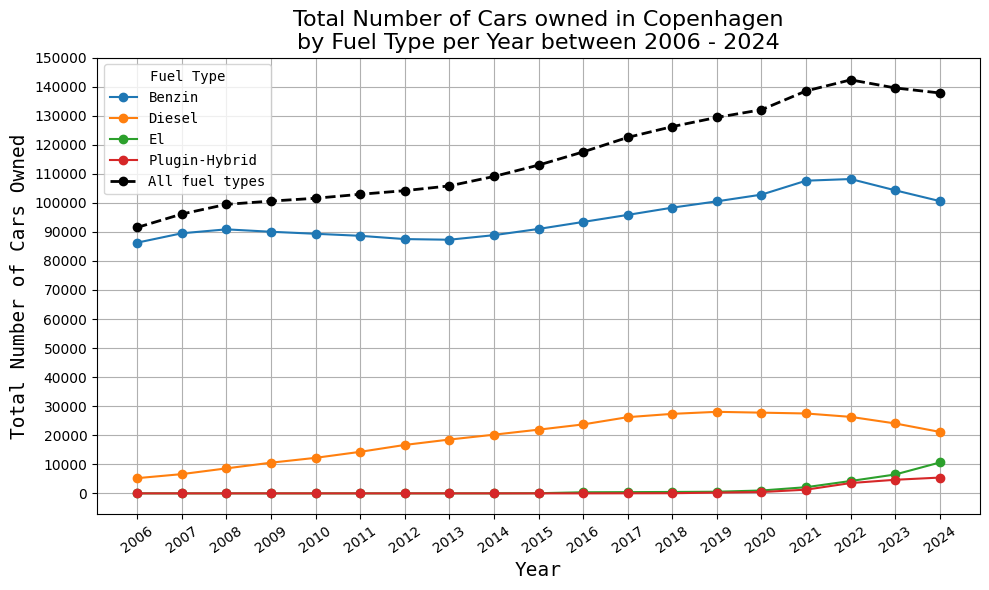

In [240]:
font_defined = "monospace"

# Group by year and fuel type, then summarize by noofvehicles, then fiannly pivot to correst format
df_grouped = df_clean.groupby(["Year", "FuelType"])["NoOfVehicles"].sum().reset_index()
df_pivot = df_grouped.pivot(index="Year", columns="FuelType", values="NoOfVehicles")

# Plot pivotted dataframe as lines
ax = df_pivot.plot(kind="line", marker='o', figsize=(10, 6))

# Compute the total no. of vehicles per year for all fuel types combined
df_total = df_pivot.sum(axis=1).reset_index()
df_total.columns = ["Year", "TotalVehicles"]
ax.plot(df_total["Year"], df_total["TotalVehicles"], color='black', marker='o', label='All fuel types', linestyle='--', linewidth=2)
    
# Force all years to show on the x-axis
ax.set_xticks(df_pivot.index)  # these are your actual year values
ax.set_xticklabels(df_pivot.index, rotation=35)  # rotate for readability

# Calculate range intervals for yticks
interval = 10_000
max_val = df_total.max().max()
top_val = int(math.ceil(max_val / interval)) * interval
ax.set_yticks(list(range(0, top_val+interval, interval)))

# Set title, labels, legeng and grid
plt.rcParams['font.family'] = font_defined
plt.title(f"Total Number of Cars owned in Copenhagen\nby Fuel Type per Year between 2006 - 2024", fontsize=16)
plt.xlabel("Year", fontdict={'family':font_defined,'color':'black','size':14})
plt.ylabel("Total Number of Cars Owned", fontdict={'family':font_defined,'color':'black','size':14})
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles=handles, labels=labels, title="Fuel Type")
plt.grid(visible=True)

plt.tight_layout()
plt.savefig(os.path.join(plots_path, "Vehicle_ownership_CPH_2006_2024.pdf"))
plt.show()

*Figure 3: Timeseries showing the total number of cars owned per fuel type.*

<span style="color:DodgerBlue">
The above graph shows how the total number of cars owned has been steadily growing since 2006 with a peak in 2022 whereafter they seem to be in decline. The decline is especially visible in the Diesel cars as well as Benzin. Although, the Hybrid and Electric vehicles have been increasing, they still do not compare to the decline in the other fuel types.
</span>

### **Parking Spaces**

<span style="color:DodgerBlue">
While examining the parking space dataset, we were curious to explore how the creation and correction years distributed the parking spaces. 
<br><br>
Comparing these gave deep insight into the development of parking spaces in Copenhagen during the years since 2020. 
<br><br>
Additionally, as we found the creation date distribution very left tailed, we contactied the owners of the original dataset to clarify the columns and how the dataset is generated.
<br><br>
It turned out, that "creation" in their vocabulary refers to the date when the parking space was registered in their internal system, i.e. not neccesarily the actual date of when the parking space was created. However, the correction dates are supposedly accurate, meaning that the correction years is the most reliable timeseries for the parking spaces. 
</span>

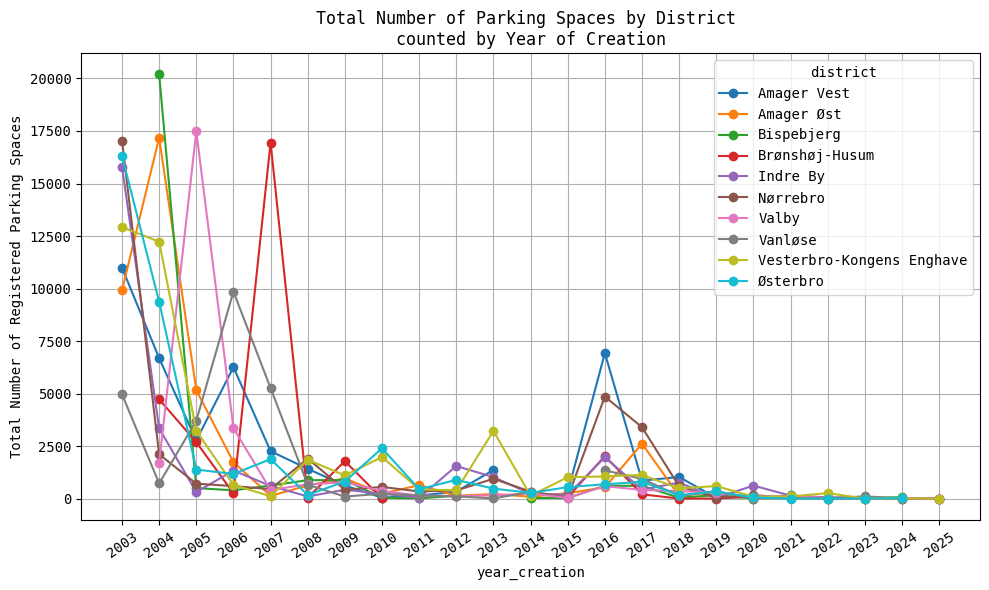

In [241]:
col_of_interest = "year_creation"

# Drop duplicates based on original unique entries
df_unique = df_parking_yearly.drop_duplicates(subset=[col_of_interest, "year_active", "district", "no_of_spaces"])

# Group rows to count the total number of spaces
df_grouped = df_unique.groupby([col_of_interest, "district"])["no_of_spaces"].sum().reset_index()
df_pivot = df_grouped.pivot(index=col_of_interest, columns="district", values="no_of_spaces")

# Plot pivotted dataframe as lines
df_pivot.index = df_pivot.index.astype(int)
ax = df_pivot.plot(kind="line", marker='o', figsize=(10, 6))
   
# Force all years to show on the x-axis
ax.set_xticks(df_pivot.index)  # these are your actual year values
ax.set_xticklabels(df_pivot.index, rotation=35)  # rotate for readability
plt.ylabel("Total Number of Registered Parking Spaces", fontdict={'family':font_defined})

# Set title, labels, legeng and grid
plt.grid(visible=True)

plt.title("Total Number of Parking Spaces by District \ncounted by Year of Creation")

plt.tight_layout()
plt.savefig(os.path.join(plots_path, "Total_parking_spaces_by_district_by_year_creation.pdf"))
plt.show()

*Figure 4: The total number of parking spaces per district counted by the creation year.*

<span style="color:DodgerBlue">
As seen in the plot above, the creation dates are heavily grouped in thee first few years of the dataset with minor spikes in 2010, 2013, 2016 and 2017.
<br><br>
Interestingly, as we were informed that the creation date is actually the date of internal registration, it seems that each of the early years show a focus on different districts, e.g. Bisperbjerg being counted in 2004, Valby in 2005 and Brønshøj-Husum in 2007.  
</span>

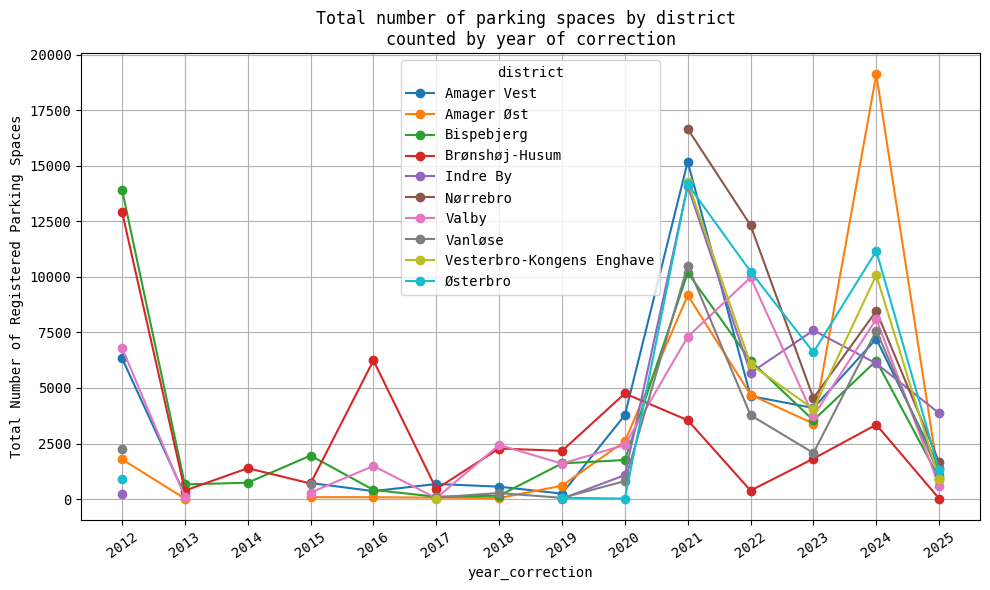

In [242]:
col_of_interest = "year_correction"

# Drop duplicates based on original unique entries
df_unique = df_parking_yearly.drop_duplicates(subset=[col_of_interest, "year_active", "district", "no_of_spaces"])

# Group rows to count the total number of spaces
df_grouped = df_unique.groupby([col_of_interest, "district"])["no_of_spaces"].sum().reset_index()
df_pivot = df_grouped.pivot(index=col_of_interest, columns="district", values="no_of_spaces")

# Plot pivotted dataframe as lines
df_pivot.index = df_pivot.index.astype(int)
ax = df_pivot.plot(kind="line", marker='o', figsize=(10, 6))
   
# Force all years to show on the x-axis
ax.set_xticks(df_pivot.index)  # these are your actual year values
ax.set_xticklabels(df_pivot.index, rotation=35)  # rotate for readability
plt.ylabel("Total Number of Registered Parking Spaces", fontdict={'family':font_defined})

# Set title, labels, legeng and grid
plt.grid(visible=True)

plt.title("Total number of parking spaces by district \ncounted by year of correction")

plt.tight_layout()
plt.savefig(os.path.join(plots_path, "Total_parking_spaces_by_district_by_year_correction.pdf"))
plt.show()

*Figure 5: The total number of parking spaces per district counted by the correction year.*

<span style="color:DodgerBlue">
The above plot shows how the parking spaces have been updated over the years. 
<br><br>
Interestingly, the first year in this timeseries is 2012 as opposed to 2003 for the year of creation.
</span>

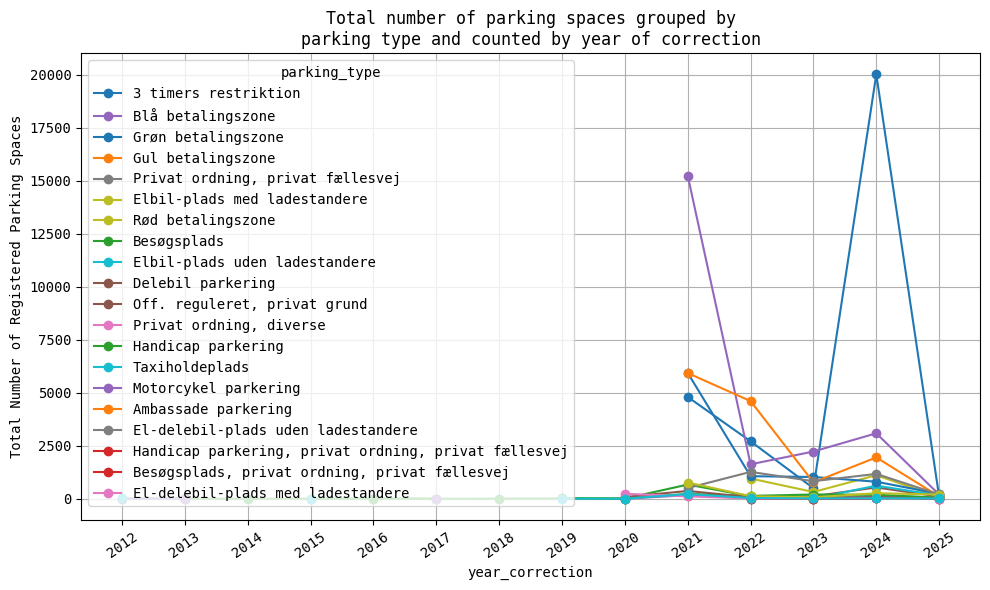

In [243]:
col_of_interest = "year_correction"
col_of_classification = "parking_type"

# Group rows to count the total number of spaces
df_grouped = df_parking[df_parking["parking_type"]!="nan"].groupby([col_of_interest, col_of_classification])["no_of_spaces"].sum().reset_index()
df_pivot = df_grouped.pivot(index=col_of_interest, columns=col_of_classification, values="no_of_spaces")

# Plot the pivoted dataframe as lines
df_pivot.index = df_pivot.index.astype(int)
ax = df_pivot.plot(kind="line", marker='o', figsize=(10, 6))

# Force all years to show on the x-axis
ax.set_xticks(df_pivot.index)
ax.set_xticklabels(df_pivot.index, rotation=35)
plt.ylabel("Total Number of Registered Parking Spaces", fontdict={'family':font_defined})

# Sort legend entries by max column values (descending)
handles, labels = ax.get_legend_handles_labels()

# Get max values for each column
max_values = df_pivot.max()

# Create sorted order by descending max values
sorted_labels = sorted(labels, key=lambda x: max_values[x], reverse=True)

# Reorder handles and labels accordingly
sorted_handles = [handles[labels.index(lbl)] for lbl in sorted_labels]

# Set the sorted legend
ax.legend(sorted_handles, sorted_labels, title=col_of_classification)

# Set title, labels, legeng and grid
plt.grid(visible=True)
plt.title("Total number of parking spaces grouped by\nparking type and counted by year of correction")
plt.tight_layout()
plt.savefig(os.path.join(plots_path, "Total_parking_spaces_by_parking_type_by_year_correction.pdf"))
plt.show()

*Figure 6: The total number of parking spaces per parking type counted by the correction year.*

<span style="color:DodgerBlue">
To examine the correction year peaks in the previous plot, we decided to look closer at the parking types of these corrected parking spaces.
<br><br>
From this, we can see that the majority of corrections were related to the recently added 3 hour parking restrictions as well as expanded paid parking zones, such as "Blå betalingszone".
<br><br>
Although, tiny compared the prior mentioned restrictions, electric vehicle parkings have also been implemented in place of previously universal parking spaces.
</span>

In [244]:
# Initialise the folium map at the center of CPH
map_parking_spaces = folium.Map(
    location=[CPH_CENTER_COORDS[1], CPH_CENTER_COORDS[0]],
    zoom_start=12, 
    tiles="cartodbpositron"
)

# Parse geojson data into the heatmap
folium.GeoJson(
    geojson_parking_spaces,
    name = "Districts",
    highlight_function=lambda feature: {
        "color": "blue",
        "fillOpacity": 0.3,
        "weight": 5.0,
        "dashArray": "1, 1",
    },
    style_function = lambda feature: {
        # "fillColor": "red",
        "color": "black",
        "weight": 2.0,
        "fillOpacity": 0.3,
        "dashArray": "3, 3",
    },
).add_to(map_parking_spaces)

map_parking_spaces

*Figure 7: Simple Folium map showing each parking space registered in Copenhagen.*

<span style="color:DodgerBlue">
In order to get an idea of where the parking spaces are concentrated within the different districts, we wanted to see them plotted on top of Copenhagen.
<br><br>
As seen in the map above, the outline of the parking spaces follow the public roads closely, leaving gaps for parks, larger buildings and tight streets such as the once around Christians Borg and the main street, Strøget.
</span>

### ***Parking Counts***

<span style="color:DodgerBlue">

To get an understanding of how parking counts have changed over the years. <br>
We explore the mean occupancy in Copenhagen per year and per each time of the day.

</span>

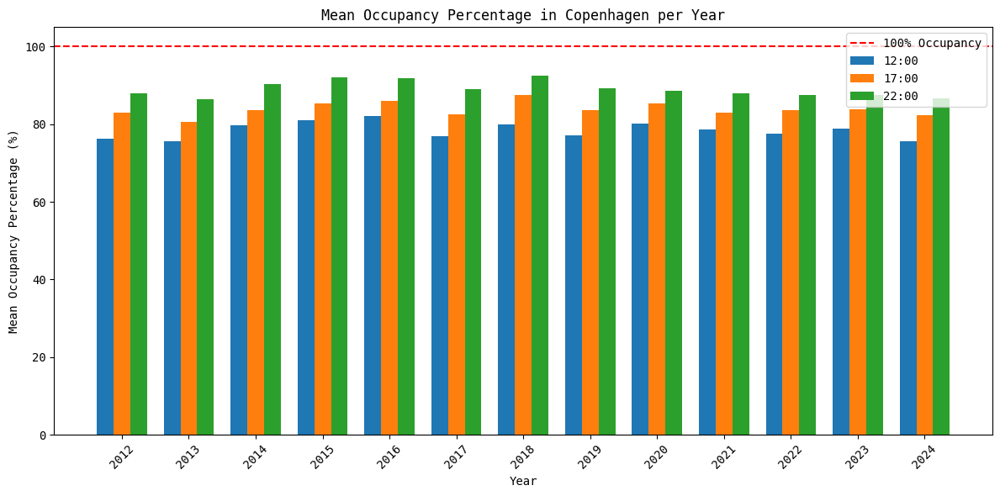

In [245]:
# --- Convert Relevant Columns to Numeric ---
# List of columns for parked cars and occupancy percentages.
parked_cols = ["parked_cars_at_12", "parked_cars_at_17", "parked_cars_at_22"]
occ_cols = ["occupancy_at_12_pct", "occupancy_at_17_pct", "occupancy_at_22_pct"]

# Ensure these columns are numeric (coercing errors if needed)
for col in parked_cols + occ_cols:
    df_counts[col] = pd.to_numeric(df_counts[col], errors='coerce')

# Also ensure the 'year' column is numeric
df_counts['year'] = pd.to_numeric(df_counts['year'], errors='coerce')

# --- Group Data by Year ---z
# Rather than grouping over all columns, group only the numeric columns you care about.
grouped_parked = df_counts.groupby("year")[parked_cols].mean()   # Using mean() per year (change to sum() if needed)
grouped_occ = df_counts.groupby("year")[occ_cols].mean()

# Retrieve the sorted years list
years = grouped_parked.index.astype(int).tolist()

# Setup x-axis positions for grouped bar charts
x = np.arange(len(years))
width = 0.25  # width for each individual bar

# --- Plot 2: Mean Occupancy Percentage per Year ---
plt.figure(figsize=(12, 6))
plt.bar(x - width, grouped_occ["occupancy_at_12_pct"], width=width, label="12:00")
plt.bar(x, grouped_occ["occupancy_at_17_pct"], width=width, label="17:00")
plt.bar(x + width, grouped_occ["occupancy_at_22_pct"], width=width, label="22:00")

plt.axhline(100, color='red', linestyle='--', linewidth=1.5, label="100% Occupancy")

plt.xlabel("Year")
plt.ylabel("Mean Occupancy Percentage (%)")
plt.title("Mean Occupancy Percentage in Copenhagen per Year")
plt.xticks(x, years, rotation=45)
plt.legend()
plt.tight_layout()
plt.show()


*Figure 8: The average percent of parking spaces occupied at three intervals over the years.*

<span style="color:DodgerBlue">

Figure 8 shows the average occupancy in Copenhagen per Year at the three measures times. The occupancy increases with a later time of day, but generally seems rather steady over the years. It varies between 75 and 90% depending on the time of the day and seems like it is slightly decreasing from 2018 to 2024. Generally, this plot needs further exploration to get a more precise overview over the parking occupancy in Copenhagen.

</span>

---

## **3. Data Analysis**

- _[Describe the analytical methods used: descriptive, inferential, or predictive]_
- _[Summarize insights discovered]_


---

## **4. Genre**

- **Which genre of data story did you use?**  
Slideshow. We find the Slideshow type to be great for interactivity as it allows the user to quickly go to the specific parts of the analysis that they want to dive into. By separating our webpage into tabs, we can serve the information in smaller and easier to digest portions. It also serves the additional advantage of allowing us to separate our "story" into "chapters" which allows us to clearly show different angles of the problem without confusing the user(s).

- **Visual Narrative Tools (Segal & Heer - Figure 7):**  
  - Consistent Visual Platform
  - Zooming
  - Feature Distinction

- **Narrative Structure Tools (Segal & Heer - Figure 7):**  
  - Linear
  - User Directed Path (User can skip slides)
  - Hover Highlighting, Details
  - Filtering, Selection
  - Captions / Headlines
  - Annotations
  - Accompanying Article (citations)
  - Introductory Text


---

## 5. **Visualizations**

**Visualisation of vehicle ownership in CPH**

<span style="color:DodgerBlue">

To get an understanding of how vehicles have changed over the years by fuel type, we can plot a graph over Copenhagen and the districts, displaying the registered vehicles per fuel type in the corresponding area. 

These plots are then stored in the _plots_-folder for later access.

</span>

In [246]:
# Interactive plot for the number of vehicles owned in each city district and Copenhagen generally

# --- Add All Districts as a whole to the dropdown options ---
district_names = ["All Districts"] + sorted(df_ownership['CityDistrict'].dropna().unique())

# --- Preprocess data per district (and All Districts as a whole) ---
all_grouped_data = {}

for district in district_names:
    if district == "All Districts":
        df_filtered = df_ownership.copy()
    else:
        df_filtered = df_ownership[df_ownership["CityDistrict"] == district]
    
    df_grouped = df_filtered.groupby(["Year", "FuelType"])["NoOfVehicles"].sum().reset_index()
    df_pivot = df_grouped.pivot(index="Year", columns="FuelType", values="NoOfVehicles").fillna(0)
    df_pivot["TotalVehicles"] = df_pivot.sum(axis=1)
    df_pivot = df_pivot.reset_index()
    df_pivot["Year"] = df_pivot["Year"].astype(int)
    all_grouped_data[district] = df_pivot

# --- Construct JS-compatible data_map ---
data_map = {}
y_max = 0
for district, df in all_grouped_data.items():
    data_dict = {col: list(df[col]) for col in df.columns}
    data_map[district] = data_dict
    if district != "All Districts":
        y_max = max(y_max, max(data_dict["TotalVehicles"]))

# --- Initial plot data ---
initial_district = "All Districts"
initial_df = all_grouped_data[initial_district]
source = ColumnDataSource(initial_df)

# --- Set up plot ---
p = figure(
    title=f"No. of Vehicles Owned in {initial_district} by Fuel Type counted per Year",
    x_axis_label="Year", y_axis_label="No. of Vehicles Owned",
    width=800, height=400,
    y_range=(0, max(initial_df["TotalVehicles"]) * 1.05)
)

p.yaxis.formatter = NumeralTickFormatter(format="0")

colors = ["blue", "green", "orange", "red", "purple", "brown", "gray"]

# Get actual fuel types dynamically from data (to avoid mismatch)
fuel_types = [col for col in initial_df.columns if col not in ("Year", "TotalVehicles")]
plot_cols = fuel_types + ["TotalVehicles"]

for i, col in enumerate(plot_cols):
    color = colors[i % len(colors)]
    legend_name = "All Fuel Types" if col == "TotalVehicles" else col

    line = p.line(x='Year', y=col, source=source, line_width=2, legend_label=legend_name, color=color)
    p.scatter(x='Year', y=col, source=source, size=6, color=color, marker="circle")

    hover = HoverTool(
        tooltips=[("Year", "@Year"), (legend_name, f"@{{{col}}}")],
        mode='mouse',
        renderers=[line]
    )
    p.add_tools(hover)

p.legend.title = "Fuel Type"
p.legend.location = "top_left"
p.xaxis.ticker = sorted(df_ownership["Year"].unique())

# --- Dropdown selector ---
select = Select(title="Select Area:", value=initial_district, options=district_names)

callback = CustomJS(args=dict(source=source, select=select, data_map=data_map, plot=p, y_max=y_max), code="""
    const district = select.value;
    const data = data_map[district];
    source.data = data;
    plot.title.text = `No. of Vehicles owned in ${district} by Fuel Type over Time`;
    if (district === "All Districts") {
        const newMax = Math.max(...data["TotalVehicles"]) * 1.05;
        plot.y_range.start = 0;
        plot.y_range.end = newMax;
    } else {
        plot.y_range.start = 0;
        plot.y_range.end = y_max * 1.05;
    }
    source.change.emit();
""")
select.js_on_change('value', callback)

# Export to HTML
# html = file_html(column(select, p), CDN, "Vehicle Ownership")
# output_path = "../plots/Project/vehicle_ownership_plot.html"
# with open(output_path, "w", encoding="utf-8") as f:
#     f.write(html)

# Show in notebook --> Restart kernel and comment these lines to export the HTML file
output_notebook()
show(column(select, p))


Loading BokehJS ...

*Figure 9: Interactive plot of cars registered in Copenhagen seperated by fuel type.*

<span style="color:DodgerBlue">

In Figure 9 it is visible that the overall trend of the number of vehicles per fuel type in each district are similar. Whilst the quantity of cars per district varies, which could be related to the size of the district, the trend shows that the number of vehicles of any fuel type and Benzin constantly increased until 2022 and decreased from 2022 to 2024. The cars with Diesel stagnated earlier (from approx. 2018) and the electric or plugin-hybrid cars are steadily increasing since 2020. In some districts the changes are more apparent than in others or vary slightly, but the overall trend is the same. 

We chose to intentionally leave the y-axis of the plot constant for all districts to better visualize the differences in the number of cars. This plot was chosen to allow us to see whether the registered cars and parking spot restrictions (e.g., through electric car parking spots) align, and whether there might be differences in car ownership based on the type of cars. It also allows for an investigation on differences between the districts.

</span>

**Visualisation of parking space data in CPH**

<span style="color:DodgerBlue">

To get an understanding of how parking spaces have changed over the years, we can plot some graphs using the custom timeseries we generated. 

These plots are then stored in the _plots_-folder for later access.

</span>

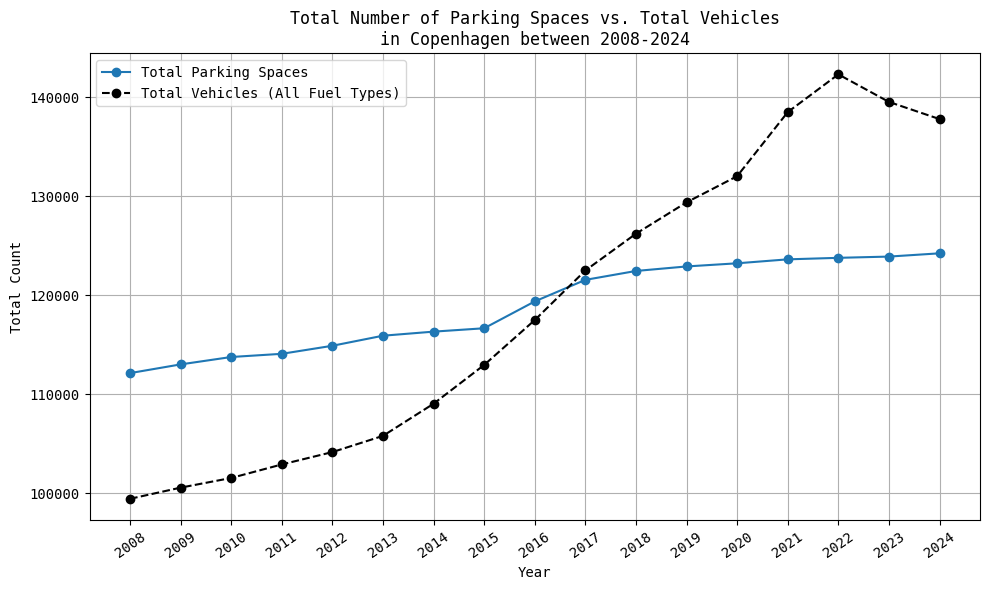

In [247]:
# Plot showcasing the total number of parking spaces in CPH with the total number of vehicles registered in the city (>= 2008)

# --- Filter and group parking data ---
col_of_interest = "year_active"
df_spaces = df_parking_yearly[df_parking_yearly[col_of_interest] >= "2008"]
df_spaces_grouped = df_spaces.groupby([col_of_interest])["no_of_spaces"].sum().reset_index()
df_spaces_grouped[col_of_interest] = df_spaces_grouped[col_of_interest].astype(int)

# --- Get total vehicles in Copenhagen ---
df_vehicles = all_grouped_data["All Districts"][["Year", "TotalVehicles"]].copy()
df_vehicles = df_vehicles[df_vehicles["Year"] >= 2008]

# --- Merge on year ---
df_merged = pd.merge(
    df_spaces_grouped,
    df_vehicles,
    left_on=col_of_interest,
    right_on="Year",
    how="inner"
)

# --- Plot both lines ---
fig, ax = plt.subplots(figsize=(10, 6))

# Plot total parking spaces
ax.plot(
    df_merged[col_of_interest],
    df_merged["no_of_spaces"],
    marker="o",
    label="Total Parking Spaces"
)

# Plot total vehicles
ax.plot(
    df_merged["Year"],
    df_merged["TotalVehicles"],
    marker="o",
    label="Total Vehicles (All Fuel Types)",
    linestyle="--",
    color="black"
)

# Set figure title and labels
ax.set_xticks(df_merged[col_of_interest])
ax.set_xticklabels(df_merged[col_of_interest], rotation=35)
ax.set_title("Total Number of Parking Spaces vs. Total Vehicles\nin Copenhagen between 2008-2024")
ax.set_xlabel("Year")
ax.set_ylabel("Total Count")
ax.legend()
ax.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(plots_path, "Total_parking_spaces_by_year_active.pdf"))
plt.show()


*Figure 10: Registered street parking spaces and registered cars in Copenhagen.*

<span style="color:DodgerBlue">

Figure 10 showcases that whilst the street parking spaces only slightly increased over the years (since 2008), the number of registered vehicles increased significantly up until 2022. The number of vehicles that are registered surpassed the number of street parking spaces in 2017. 

This visualization sparked the investigation into different parking scenarios. It also counters the impression that the occupancy plot provided, namely that the number of street parking spaces changed similarly to registered vehicles, as the occupancy stayed constant (or even decreased slighlty). This plot was very important for our data analysis, as it brought a new view on the situation that we intended to explore. 

</span>

**Districts and parking spaces**

<span style="color:DodgerBlue">
Exploring which districts has the most parking spaces. 

</span>

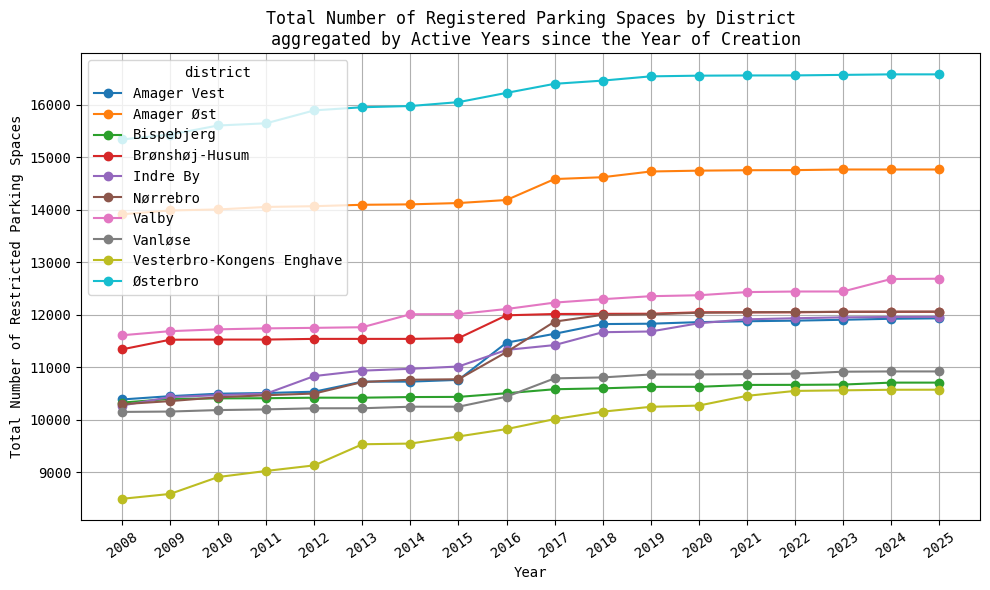

In [248]:
col_of_interest = "year_active"

# Group rows to count the total number of spaces
df_grouped = df_parking_yearly[df_parking_yearly["year_active"]>="2008"].groupby([col_of_interest, "district"])["no_of_spaces"].sum().reset_index()
df_pivot = df_grouped.pivot(index=col_of_interest, columns="district", values="no_of_spaces")

# Plot pivotted dataframe as lines
df_pivot.index = df_pivot.index.astype(int)
ax = df_pivot.plot(kind="line", marker="o", figsize=(10, 6))
   
# Force all years to show on the x-axis
ax.set_xticks(df_pivot.index)  # these are your actual year values
ax.set_xticklabels(df_pivot.index, rotation=35)  # rotate for readability
plt.ylabel("Total Number of Restricted Parking Spaces", fontdict={'family':font_defined})
plt.xlabel("Year", fontdict={'family': font_defined})

# Set title, labels, legeng and grid
plt.grid(visible=True)
plt.title("Total Number of Registered Parking Spaces by District\n aggregated by Active Years since the Year of Creation")
plt.tight_layout()
plt.savefig(os.path.join(plots_path, "Total_parking_spaces_by_district_by_year_active.pdf"))
plt.show()

*Figure 11: Total registered parking spaces by year and by district*

<span style="color:DodgerBlue">

ToDo

</span>

**Restrictions on parking spaces**

<span style="color:DodgerBlue">
The dataset contains informations about whether restrictions have been placed on a parking space. This is important inofmration as the type of restriction impacts how useable a parking space is. 
</span>

In [249]:
# Bokeh barplot with each year along the x-axis and each restriction/parking type stacked on top of one another (>="2020")
# Group parking types into meaningful, exclusive categories

# --- Define parking type groups ---
type_map = {
    # Electric Vehicle
    "Elbil-plads med ladestandere": "Electric Vehicle",
    "Elbil-plads uden ladestandere": "Electric Vehicle",

    # Car Sharing
    "El-delebil-plads med ladestandere": "Car Sharing",
    "El-delebil-plads uden ladestandere": "Car Sharing",
    "Delebil parkering": "Car Sharing",

    # Payment Zones
    "Blå betalingszone": "Payment Zone",
    "Grøn betalingszone": "Payment Zone",
    "Rød betalingszone": "Payment Zone",
    "Gul betalingszone": "Payment Zone",

    # Visitor/Time Limited
    "3 timers restriktion": "Visitor or Time Limited",
    "Besøgsplads": "Visitor or Time Limited",
    "Besøgsplads, privat ordning, privat fællesvej": "Visitor or Time Limited",

    # Accessible
    "Handicap parkering": "Accessible",
    "Handicap parkering, privat ordning, privat fællesvej": "Accessible",

    # Taxi
    "Taxiholdeplads": "Taxi",

    # Motorcycle
    "Motorcykel parkering": "Motorcycle",

    # Diplomatic
    "Ambassade parkering": "Diplomatic",

    # Private
    "Privat ordning, privat fællesvej": "Private",
    "Privat ordning, diverse": "Private",
    "Off. reguleret, privat grund": "Private"
}

# --- Map to new column ---
df_filtered = df_parking[df_parking["year_correction"] >= "2020"].copy()
df_filtered["grouped_type"] = df_filtered["parking_type"].map(type_map).fillna("Other")

# --- Group and pivot ---
grouped = df_filtered.groupby(["year_correction", "grouped_type"])["no_of_spaces"].sum().reset_index()
df_pivot = grouped.pivot(index="year_correction", columns="grouped_type", values="no_of_spaces").fillna(0)
df_pivot.index.name = "Year"
df_pivot = df_pivot.sort_index().astype(int)

# --- Compute totals and percentages ---
df_pivot["Total"] = df_pivot.sum(axis=1)
group_labels = list(df_pivot.columns.drop("Total"))
group_totals = df_pivot[group_labels].sum().sort_values(ascending=False)
group_labels = list(group_totals.index)
years = list(df_pivot.index.astype(str))

for label in group_labels:
    df_pivot[f"{label}_pct"] = (df_pivot[label] / df_pivot["Total"] * 100).round(1)

# Sanitize group labels for tooltip-safe keys
def safe_name(label):
    return label.replace(" ", "_").replace("/", "_").replace("-", "_")

label_map = {label: safe_name(label) for label in group_labels}

source_data = {"Year": years, "Total": df_pivot["Total"].tolist()}
for label in group_labels:
    safe = label_map[label]
    source_data[safe] = df_pivot[label].tolist()
    source_data[f"{safe}_pct"] = df_pivot[f"{label}_pct"].tolist()

source = ColumnDataSource(data=source_data)

# --- Plot setup ---
p = figure(
    x_range=years,
    height=600,
    width=950,
    title="Total Number of Registered Parking Spaces with Restrictions Added by Restriction Type per Year",
    toolbar_location="above",
    tools="pan,wheel_zoom,box_zoom,reset,save"
)

# Color palette
palette = viridis(len(group_labels))

# Stacked bar plot
stackers = [label_map[label] for label in group_labels]
renderers = p.vbar_stack(
    stackers=stackers,
    x='Year',
    width=0.8,
    color=palette,
    source=source,
    legend_label=group_labels
)

# Hover with percentages
tooltips = [("Year", "@Year"), ("Total spaces", "@Total")]
for label in group_labels:
    safe = label_map[label]
    tooltips.append((label, f"@{safe} (@{safe}_pct{{0.0}}%)"))

# Add invisible dummy bars for unified hover
dummy = p.vbar(
    x='Year', top='Total', width=0.8, source=source,
    fill_alpha=0, line_alpha=0, hover_alpha=0, name="hover_proxy"
)

hover = HoverTool(
    renderers=[dummy],
    tooltips=tooltips,
    mode="vline"
)
p.add_tools(hover)

p.yaxis.axis_label = "Number of Restricted Parking Spaces"
p.xaxis.axis_label = "Year"
p.legend.title = "Restriction Type"
p.legend.location = "top_left"

# Removed: MultiSelect and callback
layout = column(p)

# Export to HTML 
# output_file("../plots/Project/parking_spaces_by_type.html", title="Parking Spaces by Type and Year")
# save(layout)

# Show in notebook --> Restart kernel and comment these lines to export the HTML file
output_notebook()
show(layout)


Loading BokehJS ...

*Figure 12: Interactive stacked bar chart of parking spaces that have had restrictions added in a given year.*

<span style="color:DodgerBlue">

Figure 12 outlines the enforced restrictions on parking spaces between 2020 and 2025 (Note: The 2025 data is preliminary as the dataset is updated throughout the year). It is visible that the majority of restrictions implemented are regarding payment zones and time limited parking. Only a very small percentage of parking spaces are restricted because of, e.g., motorcycle parking of diplomatic parking places. It is visible that the implementation of restrictions varies per year, especially 2021 and 2024 were years where many restrictions were implemented. 

This plot is important for our story line to understand on why it seems like it is getting harder to find parking spaces, even though the number of parking spaces and occupancy seem to change only little. These restricted parking spaces are available and would not show up in the other plots, but still do not allow the majority of people to park there (at least not permanently, as it is the case with time restrictions).

</span>

**Visualisation of Parking Counts in CPH**
 
<span style="color:DodgerBlue">

To get an understanding on whether the occupancy of parking spaces in Copenhagen depends on the district, we can create some interactive graphs of the relevant data. We make an interactive plot displaying the occupancy for each given time in the selected district. 

</span>

In [251]:
# --- Clean and prepare ---
occ_cols = [
    "occupancy_at_12_pct", 
    "occupancy_at_17_pct", 
    "occupancy_at_22_pct"
]

district_shapes = {}
for feature in geojson_districts["features"]:
    name = feature["properties"]["navn"]
    geom = shape(feature["geometry"])
    district_shapes[name] = geom
def extract_centroid_from_multilinestring(wkt_str):
    try:
        geom = wkt.loads(wkt_str)
        if isinstance(geom, MultiLineString):
            return geom.centroid
    except:
        return None

def assign_real_district(wkt_str):
    centroid = extract_centroid_from_multilinestring(wkt_str)
    if centroid:
        for name, polygon in district_shapes.items():
            if polygon.contains(centroid):
                return name
    return "Unknown"

if "district" not in df_counts.columns:
    df_counts["district"] = df_counts["wkb_geometry"].apply(assign_real_district)


# --- Precompute grouped data ---
district_names = sorted([d for d in df_counts["district"].unique() if d != "Unknown"])

all_grouped_data = {
    district: df_counts[df_counts["district"] == district].groupby("year")[occ_cols].mean().reset_index() for district in district_names
}

# --- Create JavaScript data map ---
data_map = {
    d: {
        'year': list(df_counts['year']),
        'occupancy_at_12_pct': list(df_counts['occupancy_at_12_pct']),
        'occupancy_at_17_pct': list(df_counts['occupancy_at_17_pct']),
        'occupancy_at_22_pct': list(df_counts['occupancy_at_22_pct']),
    } for d, df_counts in all_grouped_data.items()
}

# --- Initial source ---
initial_district = district_names[0]
source = ColumnDataSource(data_map[initial_district])

# --- Figure ---
p = figure(title=f"Mean Occupancy Percentage in {initial_district} per Year", 
           x_axis_label="Year", y_axis_label="Mean Occupancy Percentage (%)", 
           width=800, height=400)

colors = ["blue", "green", "orange"]
markers = ["circle", "square", "triangle"]
labels = ["Occupancy at 12:00", "Occupancy at 17:00", "Occupancy at 22:00"]
renderers = []

for i, col in enumerate(occ_cols):
    line = p.line(x='year', y=col, source=source, line_width=2, legend_label=labels[i], color=colors[i])
    p.scatter(x='year', y=col, source=source, size=8, marker=markers[i], color=colors[i])
    
    hover = HoverTool(
        tooltips=[("Year", "@year"), (labels[i], f"@{col}{{0.0}}%")],
        mode='mouse',
        renderers=[line]
    )
    p.add_tools(hover)

p.legend.title = "Time of Day"
p.legend.location = "top_left"

# --- Dropdown and JS callback ---
select = Select(title="Select District:", value=initial_district, options=district_names)

callback = CustomJS(args=dict(source=source, select=select, data_map=data_map, plot=p), code="""
    const data = data_map[select.value];
    source.data = data;
    plot.title.text = `Mean Occupancy Percentage in ${select.value} per Year`;
    source.change.emit();
""")
select.js_on_change('value', callback)

# Export to HTML
# output_path = "../plots/Project/occupancy_by_district.html"
# html = file_html(column(select, p), CDN, "Occupancy by District")
# with open(output_path, "w", encoding="utf-8") as f:
#     f.write(html)

# Show in notebook --> Restart kernel and comment these lines to export the HTML file
output_notebook()
show(column(select, p))


Loading BokehJS ...

*Figure 13: Interactive figure showing occupancy percentages by District, Year and Time of Day.*

<span style="color:DodgerBlue">

Figure 13 outlines the mean parking occupancy per time of day per year in each district. It is visible that the occupancy percentages vary between districts and time of the day, and no general trend can be seen. Some districts, such as Nørrebro even have mean occupancies of over 100% in the evening (between 2014 and 2022), indicating that more cars were parked on the street than allowed. 

This plot was important to investigate as the mean occupancy in Copenhagen per year seemed rateher constant. So this introduced the fact that the availability of parking spaces depend on the city district, and that it can indeed be the case that all spaces are occupied. 

</span>

**Creating a Map**

<span style="color:DodgerBlue">

In this section, we will create some maps to visualise how the parking spaces and vehicle ownership is distributed in Copenhagen.

The maps are made using the Folium package.

</span>

Summarising data for a map:

<span style="color:DodgerBlue">

By combining the datasets covered in this project, we are able to create a clean map illustrating the state of street parking in Copenhagen.

In order to keep the displayed information simple, we summarised the different datasets onto each city district in Copenhagen, e.g. all registered parking spaces in Indre By.

</span>

In [252]:
# Summarise the total no. of parking spaces per district and use to create totals-dataframe
df_total = df_parking_geo.groupby('district', as_index=False)['no_of_spaces'].sum()

# Summarise car ownership in specific year and merge on district
df_cars = df_ownership[df_ownership["Year"]==2024].groupby('CityDistrict', as_index=False)['NoOfVehicles'].sum()
df_cars = df_cars.rename(columns={'CityDistrict': 'district', 'NoOfVehicles': 'no_of_cars'})
df_total = df_total.merge(df_cars, on='district', how='left')
 
# Summarise parking occupancies in specific year and merge on district
df_occ_12 = df_counts[df_counts["year"]==2024].groupby('district', as_index=False)['occupancy_at_12_pct'].mean().round(2)
df_total = df_total.merge(df_occ_12, on='district', how='left')

df_occ_17 = df_counts[df_counts["year"]==2024].groupby('district', as_index=False)['occupancy_at_17_pct'].mean().round(2)
df_total = df_total.merge(df_occ_17, on='district', how='left')

df_occ_22 = df_counts[df_counts["year"]==2024].groupby('district', as_index=False)['occupancy_at_22_pct'].mean().round(2)
df_total = df_total.merge(df_occ_22, on='district', how='left')

# Change NaN to "No Data Available"-user message
df_total["occupancy_at_12_pct"] = df_total["occupancy_at_12_pct"].fillna('No Data Available')
df_total["occupancy_at_17_pct"] = df_total["occupancy_at_17_pct"].fillna('No Data Available')
df_total["occupancy_at_22_pct"] = df_total["occupancy_at_22_pct"].fillna('No Data Available')

# Display total dataframe
display(df_total)

# Add the totals to each district feature
for feature in geojson_districts['features']:
    district_name = feature['properties'].get('navn')

    # Look up district in totals dataframes
    match = df_total[df_total['district'] == district_name]

    if not match.empty:
        total_spaces = int(match['no_of_spaces'].values[0])
        total_cars = int(match['no_of_cars'].values[0])
        total_occ_12 = str(match['occupancy_at_12_pct'].values[0])
        total_occ_17 = str(match['occupancy_at_17_pct'].values[0])
        total_occ_22 = str(match['occupancy_at_22_pct'].values[0])
    else:
        total_spaces = 0
        total_cars = 0
        total_occ_12 = 0
        total_occ_17 = 0
        total_occ_22 = 0

    # Add parking spaces as new property to GeoJSON data
    feature['properties']['no_of_spaces'] = total_spaces
    feature['properties']['no_of_cars'] = total_cars
    feature['properties']['occupancy_at_12_pct'] = total_occ_12
    feature['properties']['occupancy_at_17_pct'] = total_occ_17
    feature['properties']['occupancy_at_22_pct'] = total_occ_22

,district,no_of_spaces,no_of_cars,occupancy_at_12_pct,occupancy_at_17_pct,occupancy_at_22_pct
0,Amager Vest,11934,17868,65.48,73.4,77.39
1,Amager Øst,14769,13682,54.74,67.36,72.77
2,Bispebjerg,10710,11112,79.42,91.15,90.58
3,Brønshøj-Husum,12060,12162,No Data Available,No Data Available,No Data Available
4,Indre By,11962,12244,94.05,85.8,86.33
5,Nørrebro,12062,12767,81.89,91.29,95.04
6,Valby,12689,14725,67.8,76.22,81.08
7,Vanløse,10923,11024,65.29,77.12,84.45
8,Vesterbro-Kongens Enghave,10575,14405,82.86,93.31,97.97
9,Østerbro,16581,17809,78.25,89.19,95.97


*Table 9: Overview of the parking spaces and occupancies per district.*

Initializing the map:

<span style="color:DodgerBlue">

The maps are made using the Folium package.

To start, we need to initialise a Folium Map, which we can then add elements to.
</span>

In [253]:
# Initialise the folium map at the center of CPH
folium_map = folium.Map(
    location=[CPH_CENTER_COORDS[1], CPH_CENTER_COORDS[0]],
    zoom_start=12, 
    tiles="cartodbpositron"
)

Adding parking spaces in Copenhagen to Folium Map:

<span style="color:DodgerBlue">

We can add the location of the each parking space to the map, using the generated GeoJSON data. 

</span>

In [254]:
# Add the parking spaces onto the map
folium.GeoJson(
    data = geojson_parking_spaces,
    name = "Parking Spaces",
    highlight_function = lambda feature: {
        "color": "blue",
        "fillOpacity": 0.3,
        "weight": 5.0,
        "dashArray": "1, 1",
    },
    style_function = lambda feature: {
        # "fillColor": "red",
        "color": "black",
        "weight": 2.0,
        "fillOpacity": 0.3,
        "dashArray": "3, 3",
    },
).add_to(folium_map)

Adding City Districts in Copenhagen to Folium Map:

<span style="color:DodgerBlue">

We can add the city districts in Copenhagen as an overlay on top of the parking spaces.

</span>

In [255]:
# Add districts layer with tooltip (simple display of navn and areal_m2)
folium.GeoJson(
    geojson_districts,
    name = "Districts",
    highlight_function = lambda feature: {
        "fillColor": "#FFCC00",
        "fillOpacity": 0.3,
        "weight": 2.0,
        "dashArray": "1, 1",
    },
    style_function = lambda feature: {
        "fillColor": "brown",
        "color": "black",
        "weight": 1.0,
        "fillOpacity": 0.3,
        "dashArray": "3, 3",
    },
    tooltip = folium.GeoJsonTooltip(
        fields=[
            "navn", 
            "no_of_spaces", 
            "no_of_cars", 
            "areal_m2",
            'occupancy_at_12_pct',
            'occupancy_at_17_pct',
            'occupancy_at_22_pct',
        ],
        aliases=[
            "Copenhagen District", 
            "Registered Parking Spaces",
            "Registered Cars Owned", 
            "Area (m²)",
            'Occupancy (%) at 12:00',
            'Occupancy (%) at 17:00',
            'Occupancy (%) at 22:00',
        ],
        localize=True,
        sticky=False,
        labels=True,
        style=(
            "background-color: white; "
            "border: 1px solid black; "
            "border-radius: 3px; "
            "box-shadow: 3px; "
        )
    ),
    popup = folium.GeoJsonPopup(
        fields=[
            "navn", 
            "no_of_spaces", 
            "no_of_cars", 
            "areal_m2",
            'occupancy_at_12_pct',
            'occupancy_at_17_pct',
            'occupancy_at_22_pct',
        ],
        aliases=[
            "Copenhagen District", 
            "Registered Parking Spaces",
            "Registered Cars Owned", 
            "Area (m²)",
            'Occupancy (%) at 12:00',
            'Occupancy (%) at 17:00',
            'Occupancy (%) at 22:00',
        ],
        localize=True,
        labels=True,
        style=(
            "background-color: white; "
            "border: 1px solid black; "
            "border-radius: 3px; "
            "box-shadow: 3px; "
        )
    ),
    popup_keep_highlighted = True
).add_to(folium_map)

# Save and Display
folium_map_name = "CPH_folium_map.html"
folium_map_path = os.path.join(plots_path, folium_map_name)
folium_map.save(folium_map_path, close_file=False)
with open(folium_map_path, "r", encoding="utf-8") as f:
    html_content = f.read()
with open(folium_map_path, "w", encoding="utf-8") as f:
    f.write(html_content)
folium_map

*Figure 14: Interactive map of Copenhagen showing (by district) occupancy at different times, total amount of street parking and amount of cars registered.*

<span style="color:DodgerBlue">

Figure 14 shows ...

This map ...

</span>

---

## **6. Discussion – Critical Reflection**

- **What went well?**  
The project went well in many aspects. Our group work especially was organised and the work was well-divided and timely finished. We had weekly meetings to discuss the next steps and that helped the process tremendously. Most of our visualisations were inspired or based on the work we had done in previous notebooks which made it easier to quickly make visualisations look quite nice. Overall, we are happy with how the webpage and notebooks ended up looking.


- **What is still missing / could be improved?**  
We have been in communications with the people managing both datasets, and from these dialogues we have gathered that perhaps the data is not as complete as it seems and therefore some of our hypotheses or conclusions might not be perfect. It would be nice if we had time to compare our finding to either other datasets or some other national overview. We would also have loved to further improve the overall style of the webpage but chose to focus more so on the visualisations of the data, but it would have been cool to better align the style of the visualisations and the webpage. 

More aspects could be explored:
- Parking houses and their influence on street parking
- The public transportation system's effect on the need for parking spaces

---

## **7. Contributions**

| Team Member        | Primary Responsibilities                            |
|--------------------|------------------------------------------------------|
| Aleksandar (s194066)          | Car ownership dataset, Parking spaces dataset, Folium interactive map |
| Paula (s242926)              | Parking count dataset, Parking spaces dataset, Bokeh interactive plots |
| Victor (s204475)              | Website creation and Setup, time series, Video Filming and Editing, Narrative direction, Research and sources |

> Note: Each member took the lead on different components while maintaining collaborative input across all parts of the project.

---

## **8. References**

As previously mentioned, the original datasets can be found at:

<li>Parking counts – <a href="https://www.opendata.dk/city-of-copenhagen/parkeringstaellinger"
      target="_blank">parkeringstaellinger - opendata.dk</a></li>
  <li>Occupancy – <a href="https://www.opendata.dk/city-of-copenhagen/parkeringspladser" target="_blank">parkeringspladser - opendata.dk</a>
  </li>
  <li>Car ownership – <a href="https://kk.statistikbank.dk" target="_blank">kk.statistikbank.dk</a></li>
  <li>District boundaries – <a href="https://www.opendata.dk/city-of-copenhagen/bydele" target="_blank">bydele - opendata.dk</a>
  </li>

The following references are used at the website: https://aleksandarlukic96.github.io/

  <h3>Articles and ressources</h3>
  <ul>
    <li>Where parking is difficult – <a href="https://www.berlingske.dk/samfund/se-kortet-her-skal-du-ikke-regne-med-at-kunne-parkere-i-koebenhavn?gaa_at=eafs&gaa_n=AerBZYOMfhArOV8KOY2-zdwv50jJK9IwSm4ziBxkqlVAMJQH4Tzww99ZluXIYq8kZkw%3D&gaa_ts=68204c07&gaa_sig=NB_XBX4x9DeSaxTC48qFeQgBcuZ69-hLgn61dVMQuvTk1Y8f1guam7T5L0ta9vDFhAG3l1pKDVdV4eIEkG9sJQ%3D%3D" target="_blank">Berlingske</a></li>
    <li>Vanløse local committee on parking – <a href="https://vanloeselokaludvalg.kk.dk/sites/default/files/2023-09/Borgerpanel%20kommentarer%20-%20parkering%20generelt.pdf" target="_blank">Vanløse
        Lokaludvalg</a></li>
    <li>Private citizen on parking difficulties – <a href="https://nyheder.tv2.dk/2021-10-27-bruger-tusindvis-af-kroner-og-tid-paa-at-lede-efter-parkering-og-det-bliver-kun-vaerre" target="_blank">TV2</a></li>
    <li>No free Sunday parking – <a href="https://fdm.dk/nyheder/bilist/2025-03-slut-med-gratis-soendagsparkering-koebenhavn-saa-meget-skal-du-betale#:~:text=Nu%20skal%20du%20betale%20alle,og%20p%C3%A5%20s%C3%B8ndage%20og%20helligdage" target="_blank">fdm.dk</a></li>
    <li>Free parking spaces are being removed – <a href="https://nyheder.tv2.dk/lokalt/2017-03-01-se-kortet-her-er-det-nu-slut-med-gratis-parkering-i-koebenhavn" target="_blank">TV2.dk</a></li>
    <li>Effects of restricting parking – <a href="https://www.kk.dk/nyheder/tidsbegraenset-parkering-i-flere-bydel" target="_blank">kk.dk</a></li>
    <li>Cheaper electric cars – <a href="https://greenpowerdenmark.dk/nyheder/groen-aftale-giver-danskerne-billigere-elbiler" target="_blank">greenpowerdenmark.dk</a></li>
    <li>Parking spots converted to EV/Car sharing spaces – <a href="https://fdm.dk/nyheder/trafik/2021-09-koebenhavn-oeremaerker-5000-p-pladser-til-elbiler-delebiler" target="_blank">fdm.dk</a></li>
    <li>Higher parking permit costs for polluting cars – <a href="https://www.thelocal.dk/20191007/copenhagen-residents-could-pay-100-times-more-for-parking"
        target="_blank">thelocal.dk</a></li>
    <li>Parking houses –
      <a href="https://ebp.dk/en/parking-in-copenhagen/" target="_blank">dbp.dk</a>,
      <a href="https://www.visitcopenhagen.dk/koebenhavn/planlaeg-din-tur/parkeringshuse-i-koebenhavn" target="_blank">visitcopenhagen.dk</a>,
      <a href="https://copark.dk/kaempe-p-hus-aabner-snart-i-hjertet-af-koebenhavn/#:~:text=Fra%20den%201.,parkeringspladser%2C%20der%20udbydes%20til%20beboerne." target="_blank">copark.dk</a>
    </li>
    <li>Street-level parking removed – <a href="https://via.ritzau.dk/pressemeddelelse/13763116/nedlaeggelsen-af-600-p-pladser-i-byens-hjerte-naermer-sig?publisherId=13560117&lang=da" target="_blank">ritzau.dk</a></li>
    <li>Infrastructural map of Copenhagen <a href="https://kbhkort.kk.dk/spatialmap?layer=bydele" target="_blank">kbhkort.kk.dk</a> </li>
</ul>